In [273]:
# import relevant stuff (for sims)


import os
import numpy as np
import pandas as pd
from matplotlib.pyplot import *
import h5py
import datetime
import pytz
import pickle
import glob
from scipy.interpolate import griddata
import scipy.optimize as opt
from scipy.optimize import curve_fit
from scipy.optimize import leastsq
from scipy.optimize import least_squares
import math



In [274]:
## First import general packages for running python analysis:
import os, h5py, datetime,pytz
import numpy as np
from matplotlib.pyplot import *
from matplotlib import pyplot as plt
from matplotlib.colors import LogNorm
import pickle, glob, yaml, string

from scipy.interpolate import griddata
import scipy.optimize as opt
from scipy.optimize import curve_fit
from scipy.optimize import leastsq
from scipy.optimize import least_squares
from scipy.stats import binned_statistic_2d

from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LogNorm
from matplotlib.ticker import MultipleLocator

## Then import the beamcals module packages and initialize 'gbosite' class:
from beamcals import corr
from beamcals import concat
from beamcals import drone
from beamcals import bicolog
import beamcals.plotting_utils as pu
import beamcals.fitting_utils as fu
import beamcals.geometry_utils as gu
import beamcals.time_utils as tu
from beamcals import beammap as bp
import beamcals.beam_autoprocessing as ba
from beamcals.sites import site
import beamcals.reduce_ccclass as rc

gbosite=site.site('../../beamcals/beamcals/sites/GBO_config.npz')

# various gridding attempts
import pykrige.kriging_tools as kt
from pykrige.ok import OrdinaryKriging

freqs = 800.0*np.ones(1024) + (-400/1024.)*np.arange(1024)

fitdir='/hirax/GBO_Analysis_Outputs/main_beam_fits/'
ymldir = '/hirax/GBO_Analysis_Outputs/concat_config_files/'
pckldir = '/hirax/GBO_Analysis_Outputs/flight_pickles/'
ampdir = '/hirax/GBO_Analysis_Outputs/amplitude_corrections/'
beamdir = '/hirax/GBO_Analysis_Outputs/2023_SpringSummer_products/beam_pickles/' #/hirax/GBO_Analysis_Outputs/beam_pickles/'
beamdir = '/hirax/GBO_Analysis_Outputs/beam_pickles/'

# !pip3 install pickle5
import pickle5 as pickle


# Sims 

In [275]:
# set up relevant read-in functions

def lintodb_V(mags):
    mag_=10*np.log10(np.array(mags))
    return(mag_)

def lintodb(mags):
    mag_=20*np.log10(np.array(mags))
    return(mag_)

def find_indx(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return(idx)

def cstreader(file):
    data = open(file).readlines()[2::]
    theta = []
    phi = []
    gainTheta = []
    gainPhi = []
    for row in data:
        theta.append(float(row.rsplit()[0]))
        phi.append(float(row.rsplit()[1]))
        gainTheta.append(float(row.rsplit()[3]))
        gainPhi.append(float(row.rsplit()[5]))
    df = pd.DataFrame({'theta':theta, 'phi':phi, 'gain(theta)':gainTheta, 'gain(phi)':gainPhi})
    return(df)

def Theta_0(df):
    df1 = df.truncate(before=find_indx(df['phi'], 0), after=find_indx(df['phi'], 1)-1)
    return(df1)
def Theta_90(df):
    df1 = df.truncate(before=find_indx(df['phi'], -90), after=find_indx(df['phi'], -89)-1)
    return(df1)

def Theta_angle(df, angle):
    df1 = df.truncate(before=find_indx(df['phi'], angle), after=find_indx(df['phi'], angle+1)-1)
    return(df1)
        
class cst_beam_sims:
    def __init__(self, file):
        df = cstreader(file)
        self.vars = variables(df)
    def plot_CoPol(self):
        plot(self.vars.e_co[0], lintodb(self.vars.e_co[1]), label = 'E co')
        plot(self.vars.h_co[0], lintodb(self.vars.h_co[1]), label = 'H co')
    def plot_Crp(self):
        plot(self.vars.e_crp[0], lintodb(self.vars.e_crp[1]), label = 'E crp')
        plot(self.vars.h_crp[0], lintodb(self.vars.h_crp[1]), label = 'H crp')
    def plot_Hco(self):
        plot(self.vars.h_co[0], lintodb(self.vars.h_co[1]), label = 'H co')
    def plot_Eco(self):
        plot(self.vars.e_co[0], lintodb(self.vars.e_co[1]), label = 'E co')
        
class variables:
    def __init__(self, df):
        #seems mised up but also seems to work?
        
        self.e_co = [Theta_90(df)['theta'], Theta_90(df)['gain(phi)']]
        self.e_crp = [Theta_90(df)['theta'], Theta_90(df)['gain(theta)']]
        self.h_co = [Theta_0(df)['theta'], Theta_0(df)['gain(phi)']]
        self.h_crp = [Theta_0(df)['theta'], Theta_0(df)['gain(theta)']]

        self.e_co_angle, self.e_co_gain = self.e_co[0], self.e_co[1]
        self.e_crp_angle, self.e_crp_gain = self.e_crp[0], self.e_crp[1]
        self.h_co_angle, self.h_co_gain = self.h_co[0], self.h_co[1]
        self.h_crp_angle, self.h_crp_gain = self.h_crp[0], self.h_crp[1]


In [276]:
# read in sims data

dfs_sims = {}
for freq in np.arange(400,850,50):
    dfs_sims[freq] = {}
    simfile = '/hirax/cst/hirax_gbo_v1_legs/Export/Farfield/farfield_(f='\
            +str(freq/1e3)+')_[1].txt'
    
    df = cstreader(simfile)
    indicesofinterest = [i for i in range(len(df['theta'])) if -90<df['theta'][i]<90]
    r = np.sqrt(df['gain(theta)'][indicesofinterest]**2+df['gain(phi)'][indicesofinterest]**2)
    r1 = df['gain(theta)'][indicesofinterest]
    r2 = df['gain(phi)'][indicesofinterest]
    x = np.cos(np.deg2rad(df['phi'][indicesofinterest]))*np.sin(np.deg2rad(df['theta'][indicesofinterest]))
    y = np.sin(np.deg2rad(df['phi'][indicesofinterest]))*np.sin(np.deg2rad(df['theta'][indicesofinterest]))

    dfs_sims[freq]['oneD'] = cst_beam_sims(simfile)
    dfs_sims[freq]['df'] = df
    dfs_sims[freq]['mag'] = [r,r2,r1]
    dfs_sims[freq]['position'] = [np.rad2deg(x),np.rad2deg(y)] #says x and y but is still in degrees



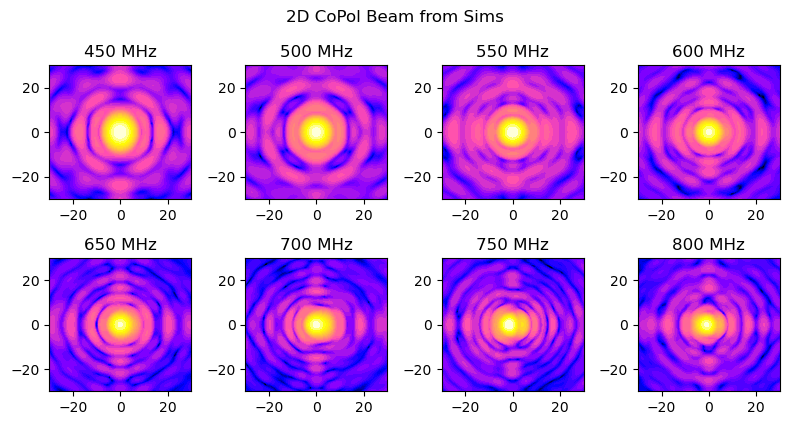

In [277]:
# plot sims data as check

fig = figure(figsize = (8, 4))
counter = 1

for freq in np.arange(450,850,50):
    ax = fig.add_subplot(2, 4, counter)
    ax.tricontourf(dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1], lintodb_V(dfs_sims[freq]['mag'][1]), 50, vmin = -10, cmap = 'gnuplot2')
    ax.set_title(str(freq)+' MHz')
    ax.set_xlim(-30,30)
    ax.set_ylim(-30,30)
    counter += 1
tight_layout()
suptitle('2D CoPol Beam from Sims', y=1.05)
show()


In [278]:
dfs_sims[freq]['position'][0]

91      -3.507820e-15
92      -3.506217e-15
93      -3.503547e-15
94      -3.499808e-15
95      -3.495004e-15
             ...     
65065    3.495004e-15
65066    3.499808e-15
65067    3.503547e-15
65068    3.506217e-15
65069    3.507820e-15
Length: 32399, dtype: float64

(-30.0, 30.0)

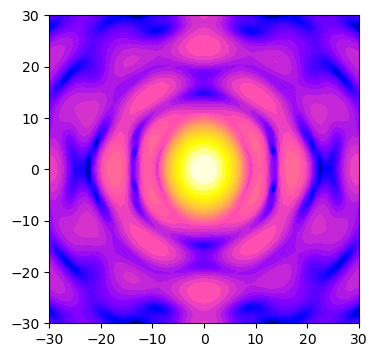

In [279]:
figure(figsize = (4,4))
freq = 450
xpos = dfs_sims[freq]['position'][0]
ypos = dfs_sims[freq]['position'][1]
tricontourf(xpos,ypos, lintodb_V(dfs_sims[freq]['mag'][1]), 50, vmin = -10, cmap = 'gnuplot2')
xlim(-30,30)
ylim(-30,30)

In [280]:
# interpolate sims onto a 2D grid used for flight data
x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
z = dfs_sims[freq]['mag'][1]

X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))

Z = griddata((x,y), z, (X,Y))


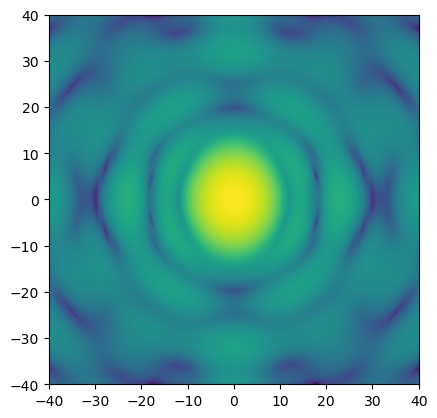

In [281]:
# plot sims data at 450MHz
imshow(10*np.log10(Z), extent=(-40,40,-40,40))
show()


# Data

In [282]:
def get_flightinfo(fly):
    for fi in range(0,len(documents["flight_info"]["flights"])):
        if fly == flights[fi]: f = fi
    
    if polarn[f]=='N':
        pols = N_pols
        cpols = E_pols
    else:
        pols = E_pols
        cpols = N_pols
    return polarn[f], pols, cpols, attns[f], f

def get_beam_diff(beam2, beam1,n):
    return beam2[:,:] - n*beam1[:,:]

def get_stat(new_d,whstat='stddev'): # default is stddev
    diff_flat = np.ndarray.flatten(new_d)
    if whstat=='stddev':
        stat = np.nanstd(diff_flat)
    elif whstat=='median':
        # compute median
        stat = np.abs(np.nanmedian(diff_flat))
    elif whstat=='sum':
        stat = np.nanmean(np.abs(diff_flat))
    elif whstat=='mednoabs':
        stat = np.nanmedian(diff_flat)
    return stat

def get_slice(beam,Z,val,ax='x'):
    # this gradually increases the tolerance until it finds something
    tol = abs(beam.x_centers_grid[0,1,0] - beam.x_centers_grid[0,0,0])/1.5
    N = len(beam.x_centers_grid[0,:,0])
    ok = True
    while(ok):
        if ax=='x':
            col = np.where((beam.x_centers_grid[0,:,0] < val+tol) & (beam.x_centers_grid[0,:,0] > val-tol))[0][0]
            n = np.count_nonzero(np.isfinite(Z)) #count number of 'good' data
            if n > 10: ok = False
            else: ok = True
        if ax=='y':
            col = np.where((beam.y_centers_grid[:,0,0] < val+tol) & (beam.y_centers_grid[:,0,0] > val-tol))[0][0]
            n = np.count_nonzero(np.isfinite(Z)) #count number of 'good' data
            if n > 10: ok = False
            else: ok = True
        tol+=3
        if tol > 30: ok = False
    return col

def get_slice_anyin(LX,LY,val,ax='x'):
    tol = abs(LX[0,1] - LX[0,0])/1.5
    if ax=='x':
        col = np.where((LX[0,:] < val+tol) & (LX[0,:] > val-tol))[0][0]
    if ax=='y':
        col = np.where((LY[:,0] < val+tol) & (LY[:,0] > val-tol))[0][0]
    return col


def get_concatlist(flights):
    #for i, fly in enumerate(flights):
    pickle_directory='/hirax/GBO_Analysis_Outputs/flight_pickles/'
    concytest=[glob.glob(pickle_directory+'*'+fly+'*')[0] for fly in flights]
    return concytest

In [283]:
with open('/hirax/GBO_Analysis_Outputs/GBO_flights_forscripts.yaml', 'r') as fff:
    documents = yaml.safe_load(fff)
flights = documents["flight_info"]["flights"]
N_pols = documents["flag_info"]["N_pols"]
E_pols = documents["flag_info"]["E_pols"]
polarn = documents["flight_info"]["pols"]
attns = documents["flight_info"]["attns"]
masks = documents["flight_info"]["masks"]
good_freqs = documents["freq_info"]["good_freqs"]

pcklarr=np.sort(os.listdir(pckldir))
gfitarr=np.sort(os.listdir(fitdir))
amparr=np.sort(os.listdir(ampdir))
# print(gfitarr,amparr)


# SLICE DEFAULTS # 
sliw = 10 # This defines slices for (some) plots
sz = 80 # use this to set the size of the Xargs and Yargs for beammapping, usually 80 or 50

# PLOTTING DEFAULT # 
cmap = matplotlib.cm.get_cmap('gnuplot2')
norm = matplotlib.colors.Normalize(vmin=-25, vmax=25)
sfig = False

Npolflights = ['618','619','625','646','647','533','536']
Epolflights = ['620','648','649','535']

In [284]:
find = good_freqs[-38]
np.linspace(800,400,1024)[find]

450.0488758553275

In [285]:
copoldir = 'N'
pols = N_pols
f_intern = 0 # only one frequency per file, this is always 0

# find = good_freqs[-1]
picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)
 

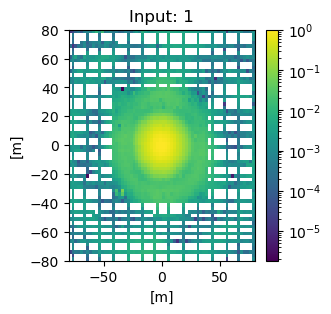

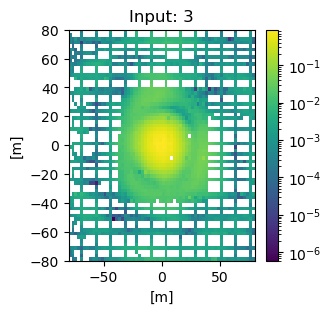

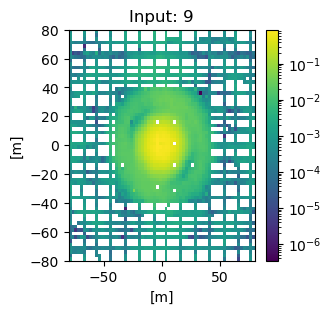

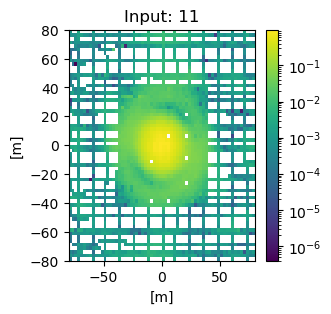

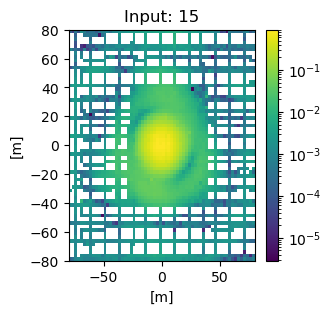

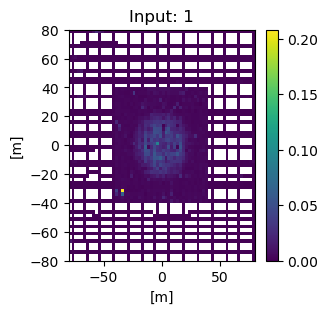

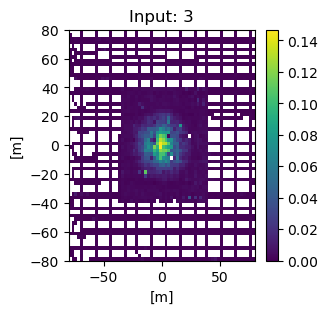

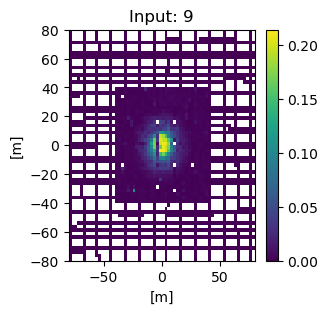

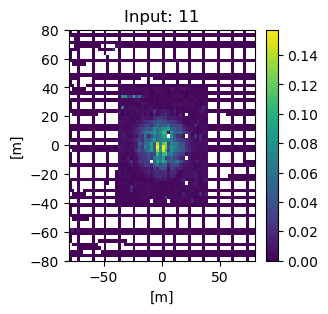

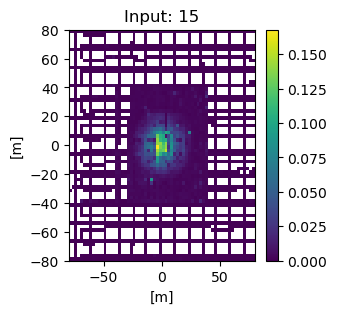

In [286]:
# set which pol:
copoldir = 'N'
pols = N_pols
f_intern = 0 # only one frequency per file, this is always 0

find = good_freqs[-38] #450MHz
picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)
    
# Plot maps and variances

for i,chind in enumerate(pols):
    fig = plt.figure(figsize=(3,3))
    plt.pcolormesh(ptest.x_centers_grid[:,:,chind],ptest.y_centers_grid[:,:,chind],
               np.abs(ptest.V_LC_operation[:,:,0,chind]),cmap=cm.viridis,norm=LogNorm())#,edgecolors='k')
    plt.xlim(-1*sz,sz)
    plt.ylim(-1*sz,sz)
    plt.xlabel('[m]')
    plt.ylabel('[m]')
    plt.title('Input: '+str(chind))
    plt.colorbar()
    plt.show()

for i,chind in enumerate(pols):
    fig = plt.figure(figsize=(3,3))
    plt.pcolormesh(ptest.x_centers_grid[:,:,chind],ptest.y_centers_grid[:,:,chind],
               ptest.V_LC_operation_err[:,:,0,chind],cmap=cm.viridis)#,edgecolors='k')
    plt.xlim(-1*sz,sz)
    plt.ylim(-1*sz,sz)
    plt.xlabel('[m]')
    plt.ylabel('[m]')
    plt.title('Input: '+str(chind))
    plt.colorbar()
    plt.show()
    
    


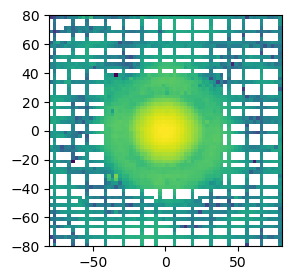

In [287]:
chind = 1

figure(figsize = (3,3))

pcolormesh(ptest.x_centers_grid[:,:,chind],ptest.y_centers_grid[:,:,chind],
               np.abs(ptest.V_LC_operation[:,:,0,chind]),cmap=cm.viridis,norm=LogNorm())#,edgecolors='k')

show()


In [288]:
ptest.V_LC_operation_err[:,:,0,chind].ravel()

array([       nan,        nan, 0.00110123, ..., 0.00090279, 0.00060207,
       0.00104351])

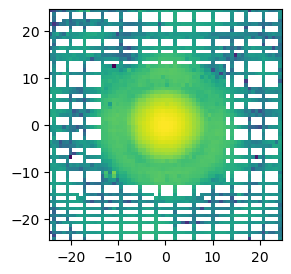

(64, 64)

In [289]:
#interp data to grid
#doing basic projection for now... 
#taking 175m height even though thats not fully accurate

xdat = np.arctan(ptest.x_centers_grid[:,:,chind]/175)*180/np.pi
ydat = np.arctan(ptest.y_centers_grid[:,:,chind]/175)*180/np.pi


chind = 1

figure(figsize = (3,3))
pcolormesh(xdat,ydat, \
           np.abs(ptest.V_LC_operation[:,:,0,chind]),cmap=cm.viridis,norm=LogNorm())
show()

xdat.shape

In [290]:
xdat_lin = xdat.ravel()
ydat_lin = ydat.ravel()
zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
valid_mask = ~np.isnan(zdat_lin)


Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')
# Z_dat = griddata((xdat_lin,ydat_lin), zdat_lin, (X,Y), method='linear')


/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in log10
  


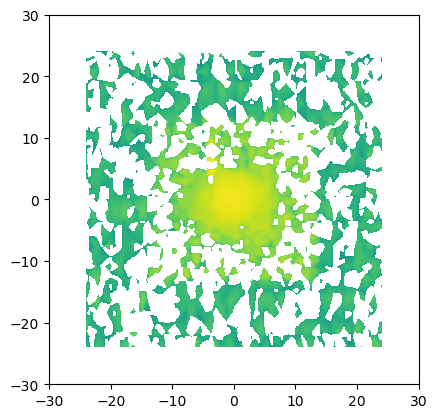

In [500]:
# plot data data at 450MHz
imshow(10*np.log10(Z_dat), extent=(-30,30,-30,30))
show()

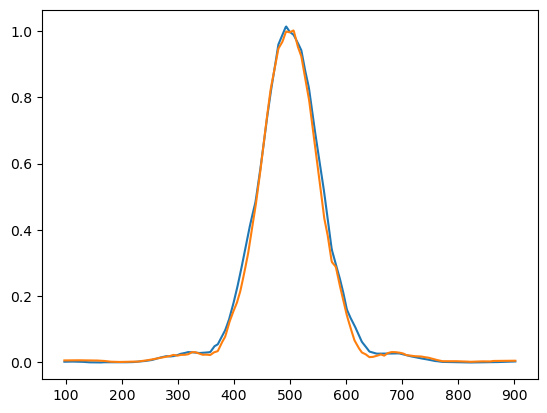

In [292]:
Z_dat.shape

plot(Z_dat[500,:])
plot(Z_dat[:,500])
show()


# Comparison

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in log
  """Entry point for launching an IPython kernel.


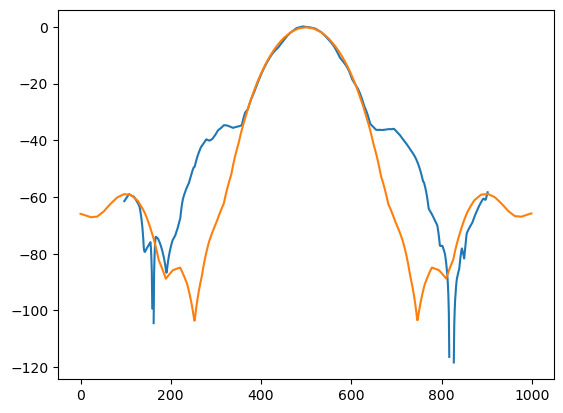

In [293]:
plot(10*np.log(Z_dat[500,:]))
# plot(Z_dat[:,500])
# plot(Z[500,:]/120)
# plot(20*np.log(Z[:,500]/120))
plot(10*np.log((Z[:,500]/120)**2))

# plot(10*np.log(Z[500,:]/120))


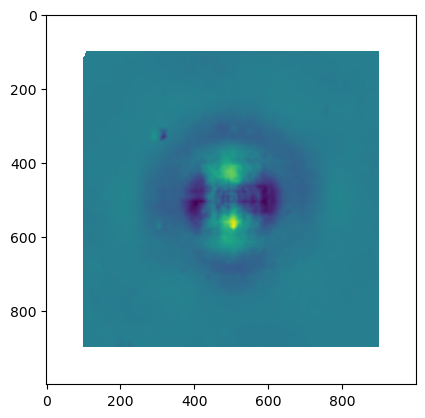

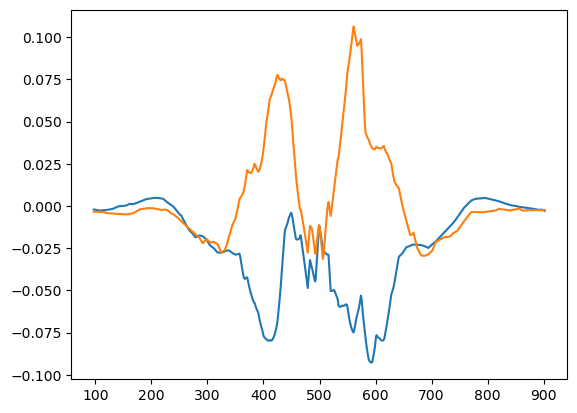

In [204]:
plot(20*np.log(Z[:,500]/120))
#find residuals between meas and sims 
# valid_mask = ~np.isnan(Z_dat)

# imshow(10*np.log10(Z/120-Z_dat))
residual = (Z/120)**2-Z_dat
imshow(residual)
show()

plot(residual[500,:])
plot(residual[:,500])


# Print bunch of plots to diagnose asymmetry in residuals by eye

In [243]:
# find freqs corresponding to sims
print(dfs_sims.keys())

f_indices = []
for i in [450,500,550,600]:
    indx = find_indx(np.linspace(800,400,1024)[good_freqs], i)
    f_indices.append(indx)
    
print(f_indices)


def find_ind_from_freq(freq):
    indx = find_indx(np.linspace(800,400,1024)[good_freqs], freq)
    return(indx)

dict_keys([400, 450, 500, 550, 600, 650, 700, 750, 800])
[112, 59, 41, 0]


In [242]:
find_freq_from_ind(450)

good_freqs[112]

895

In [322]:
np.array([1,2,3])[::-1]

array([3, 2, 1])

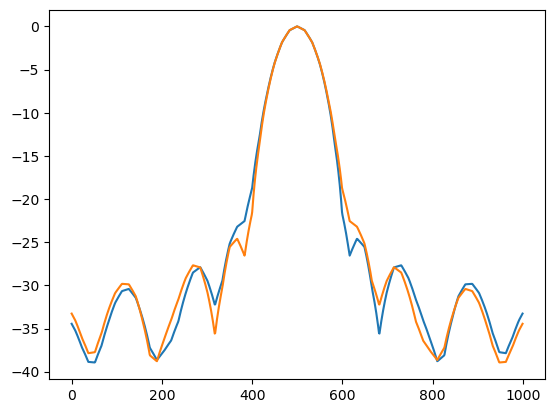

In [323]:
# imshow(10*np.log10(Z), extent=(-40,40,-40,40))
# show()

# imshow(10*np.log10(Z.transpose()), extent=(-40,40,-40,40))
# show()

plot(10*np.log(Z[500,:][::-1]))
plot(10*np.log(Z[500,:]))


try pcolormesh instead of imshow for visualizing, try log of abs or plot in lin

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in log10


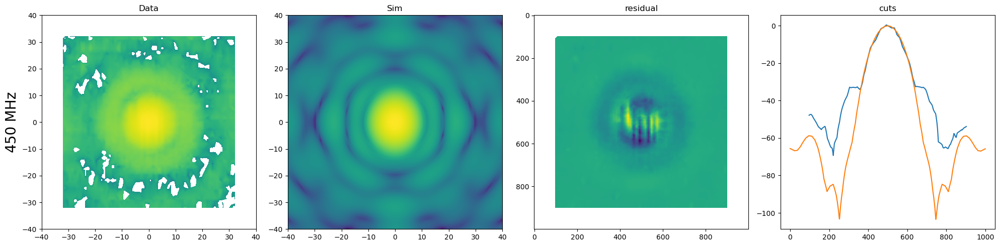

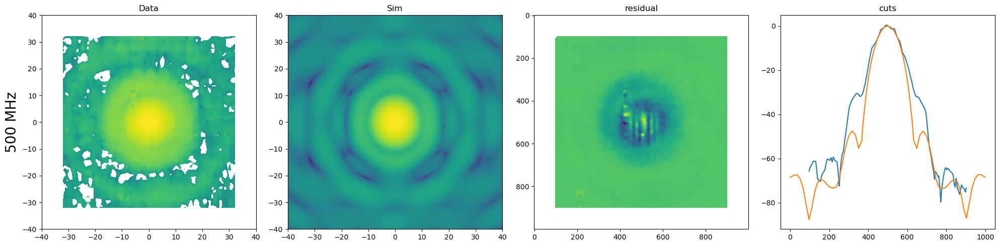

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:49: RuntimeWarning: invalid value encountered in log


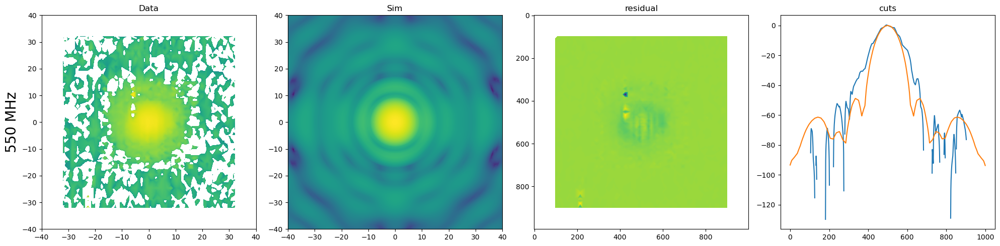

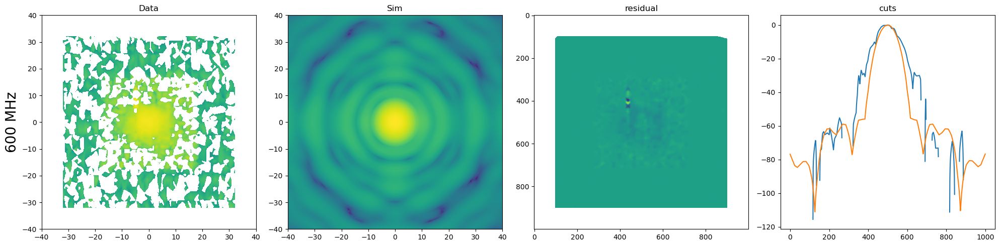

In [372]:
# read data in one place, test that it looks right for 450MHz

freq = 450

for freq in [450,500,550,600]:
    copoldir = 'E'
    pols = E_pols
    f_intern = 0 # only one frequency per file, this is always 0

    find = good_freqs[find_ind_from_freq(freq)] 

    picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
    with open(picklefile, 'rb') as inp:
        ptest = pickle.load(inp)

    chind = 0 # could change
    zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
    valid_mask = ~np.isnan(zdat_lin)


    Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')

    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)

    residual = Z.transpose()**2-Z_dat


    #plot
    figure(figsize=(20, 5))  # Adjust the figure size as needed
    subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z_dat), extent=(-40,40,-40,40))
    title('Data')
    ylabel(str(freq)+' MHz', fontsize = 20)

    subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z), extent=(-40,40,-40,40))
    title('Sim')

    subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
    imshow(residual)
    title('residual')
    
    subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
    plot(10*np.log(Z_dat[500,:]))
    plot(10*np.log(Z[:,500][::-1]**2))
#     plot(10*np.log(Z[500,:]))

    title('cuts')

    tight_layout() 
    show()

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:49: RuntimeWarning: invalid value encountered in log


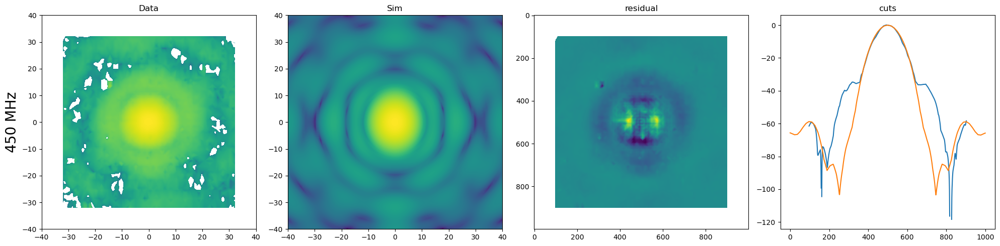

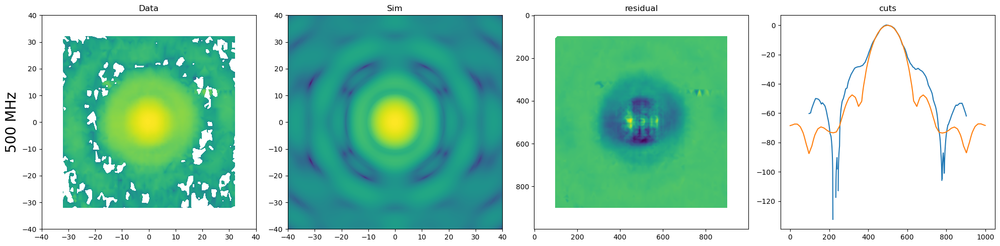

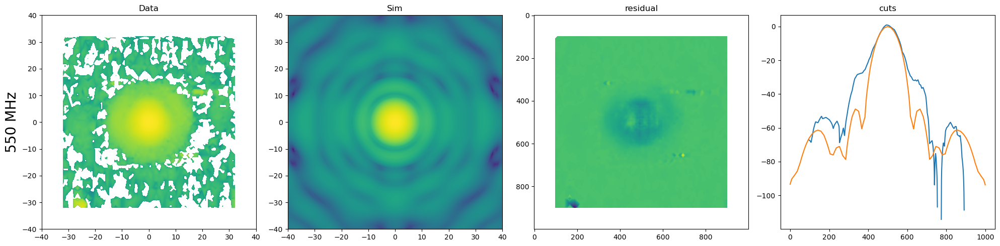

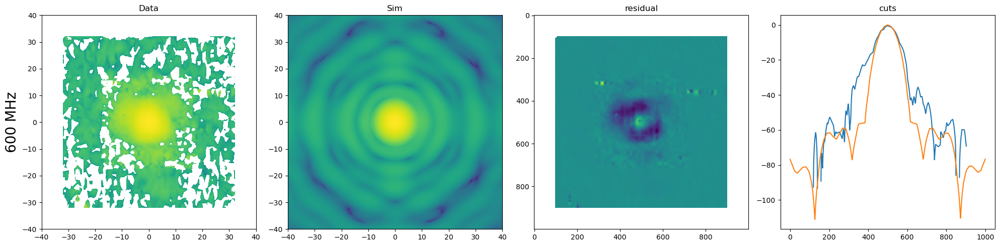

In [328]:
# read data in one place, test that it looks right for 450MHz

freq = 450

for freq in [450,500,550,600]:
    copoldir = 'N'
    pols = N_pols
    f_intern = 0 # only one frequency per file, this is always 0

    find = good_freqs[find_ind_from_freq(freq)] 

    picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
    with open(picklefile, 'rb') as inp:
        ptest = pickle.load(inp)

    chind = 1 # could change
    zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
    valid_mask = ~np.isnan(zdat_lin)


    Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')

    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)

    residual = Z.transpose()**2-Z_dat


    #plot
    figure(figsize=(20, 5))  # Adjust the figure size as needed
    subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z_dat), extent=(-40,40,-40,40))
    title('Data')
    ylabel(str(freq)+' MHz', fontsize = 20)

    subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z), extent=(-40,40,-40,40))
    title('Sim')

    subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
    imshow(residual)
    title('residual')
    
    subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
    plot(10*np.log(Z_dat[500,:]))
    plot(10*np.log(Z[:,500][::-1]**2))
#     plot(10*np.log(Z[500,:]))

    title('cuts')

    tight_layout() 
    show()

In [329]:
# Q: appropriate to square sims before comparing? think so.. 
# is data from correlator power or voltage? I think power bc its a multiplication of two voltages? 
# I think we're looking at an E-field from sims so you do need to square... 

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in log10


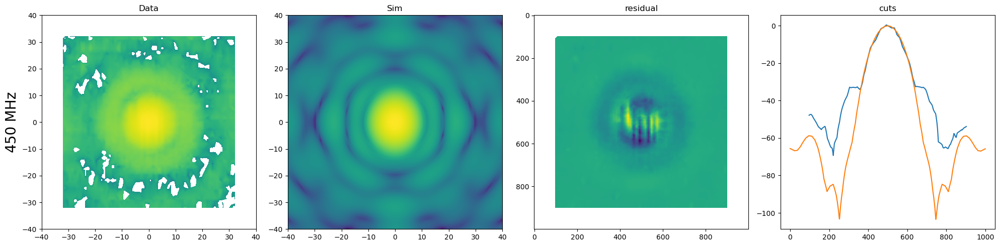

In [508]:
# read data in one place, test that it looks right for 450MHz

freq = 450

for freq in [450]:
    copoldir = 'E'
    pols = E_pols
    f_intern = 0 # only one frequency per file, this is always 0

    find = good_freqs[find_ind_from_freq(freq)] 

    picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
    with open(picklefile, 'rb') as inp:
        ptest = pickle.load(inp)

    chind = 0 # could change
    zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
    valid_mask = ~np.isnan(zdat_lin)


    Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')

    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)

    residual = Z.transpose()**2-Z_dat


    #plot
    figure(figsize=(20, 5))  # Adjust the figure size as needed
    subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z_dat), extent=(-40,40,-40,40))
    title('Data')
    ylabel(str(freq)+' MHz', fontsize = 20)

    subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z), extent=(-40,40,-40,40))
    title('Sim')

    subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
    imshow(residual)
    title('residual')
    
    subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
    plot(10*np.log(Z_dat[500,:]))
#     plot(10*np.log(Z[:,500][::-1]**2))
    plot(10*np.log(Z[:,500][::-1]**2))
#     plot(10*np.log(Z[500,:]))

    title('cuts')

    tight_layout() 
    show()

Q: in coadding all of these maps, are we washing out structure that looks artificually high in high powered beams? 

In [354]:
np.nanmean(np.abs(residual))

0.014225388764307168

# Fitting

In [350]:
#develop metric for fit... 
#start with abs mean of residuals in each cell

np.nanmean(np.abs(residual))

0.014259262769854003

In [25]:
#fit over several parameters to minimize above metric:
#rotation, projection, amplitude scaling to start

In [399]:
residual1 = np.log10(Z.transpose()**2)-np.log10(Z_dat)
residual2 = np.log10(Z**2)-np.log10(Z_dat)
print(np.nanmean(np.abs(residual1)))
print(np.nanmean(np.abs(residual2)))
print(np.nanmean(np.abs(residual1))-np.nanmean(np.abs(residual2)))

0.6429755467689307
0.6286257293664018
0.01434981740252883


/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in log10
  """Entry point for launching an IPython kernel.
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in log10
  


/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in log
  """Entry point for launching an IPython kernel.


(-60.0, 0.0)

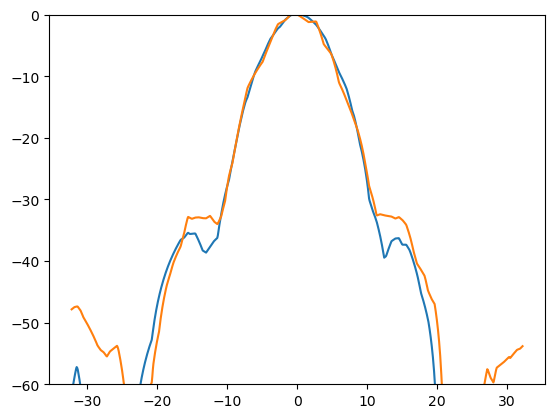

In [371]:
plot(np.linspace(-40,40,1000), 10*np.log(Z_dat[:,500]))
plot(np.linspace(-40,40,1000), 10*np.log(Z_dat[500,:]))
ylim(-60,0)

concerned that first and second sidelobes look off by 20dB, look off by 10dB in single flight maps at high power

In [382]:
def rotate(origin, point, angle):
    """
    Rotate a point counterclockwise by a given angle around a given origin.

    The angle should be given in radians.
    """
    ox, oy = origin
    px, py = point

    qx = ox + math.cos(angle) * (px - ox) - math.sin(angle) * (py - oy)
    qy = oy + math.sin(angle) * (px - ox) + math.cos(angle) * (py - oy)
    return qx, qy

In [394]:
xdat_lin_rot.shape
xdat_lin.shape

(4096,)

In [402]:
zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
valid_mask = ~np.isnan(zdat_lin)

Xrot, Yrot = rotate((0,0), (X,Y) , 45*np.pi/180)

Z_dat_rot = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (Xrot,Yrot), method='linear')


def rotate_data(angle):
    Xrot, Yrot = rotate((0,0), (X,Y) , angle*np.pi/180)
    Z_dat_rot = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (Xrot,Yrot), method='linear')
    return(Z_dat_rot)

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in log10
  """Entry point for launching an IPython kernel.


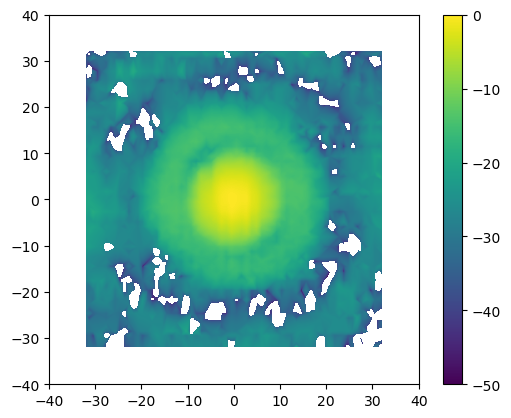

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log10
  """


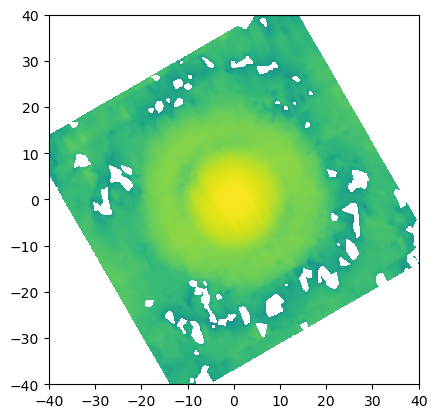

In [515]:
imshow(10*np.log10(Z_dat), extent=(-40,40,-40,40), vmax = 0, vmin = -50)
colorbar()
show()

imshow(10*np.log10(rotate_data(30)), extent=(-40,40,-40,40))
show()


In [401]:
#check that rotating gives residuals that are not crazy out of line with expected
#ie are less than sim to data residuals 
residual1 = np.log10(Z.transpose()**2)-np.log10(Z_dat)
residual2 = np.log10(Z**2)-np.log10(Z_dat)
residual3 = np.log10(Z_dat)-np.log10(Z_dat_rot)

print(np.nanmean(np.abs(residual1)))
print(np.nanmean(np.abs(residual3)))

0.6429755467689307
0.3148669793819915


/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in log10
  This is separate from the ipykernel package so we can avoid doing imports until
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log10
  """


In [406]:
from scipy.optimize import minimize


In [487]:
# try to find angle at which these two align.. spoiler it should be 0 or 180..

def objective_function(angle, Z_dat):
    rotated_map = rotate_data(angle)
    residual = (rotated_map) - (Z_dat)
    return np.nanmean(np.abs(residual)**2)

In [488]:
# Initial guess for the rotation angle
initial_angle = 10
angle_bounds = [(-45, 45)]
options = {'ftol': 1}

# Perform least squares optimization
result = minimize(objective_function, initial_angle, args=(Z**2), \
                  bounds=angle_bounds, options=options)
optimized_angle = result.x[0]

In [489]:
optimized_angle

10.0

In [490]:
best_angle = None
min_residual = float('inf')

for angle in range(angle_bounds[0][0], angle_bounds[0][1] + 1, 3):
    angle = min(angle, angle_bounds[0][1])  # Ensure the angle is within bounds
    residual = objective_function(angle, Z**2)
    if residual < min_residual:
        min_residual = residual
        best_angle = angle

In [491]:
print("Optimized Rotation Angle:", best_angle)
print("Minimum Residual:", min_residual)

Optimized Rotation Angle: 27
Minimum Residual: 0.00023694809670749757


/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in log10
  
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in log10
  from ipykernel import kernelapp as app
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in log


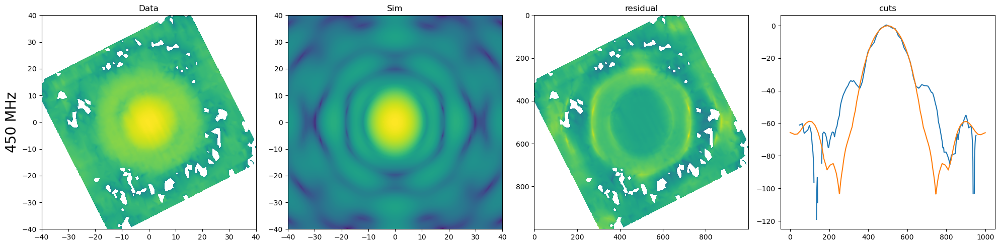

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:31: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:40: RuntimeWarning: invalid value encountered in log10


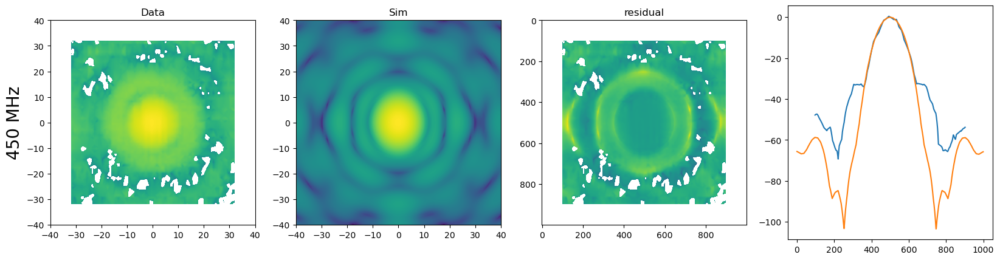

In [516]:
# read data in one place, test that it looks right for 450MHz

#plot
figure(figsize=(20, 5))  # Adjust the figure size as needed
subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(rotate_data(27)), extent=(-40,40,-40,40))
title('Data')
ylabel(str(freq)+' MHz', fontsize = 20)

subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z), extent=(-40,40,-40,40))
title('Sim')

subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(rotate_data(27))-10*np.log10(Z**2))
title('residual')

subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
plot(10*np.log(rotate_data(27)[500,:]))
#     plot(10*np.log(Z[:,500][::-1]**2))
plot(10*np.log(Z[:,500][::-1]**2))
#     plot(10*np.log(Z[500,:]))

title('cuts')

tight_layout() 
show()

figure(figsize=(20, 5))  # Adjust the figure size as needed
subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z_dat), extent=(-40,40,-40,40))
title('Data')
ylabel(str(freq)+' MHz', fontsize = 20)

subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z), extent=(-40,40,-40,40))
title('Sim')

subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z_dat)-10*np.log10(Z**2))
title('residual')

subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
plot(10*np.log(Z_dat[500,:]))
#     plot(10*np.log(Z[:,500][::-1]**2))
plot(10*np.log(Z[:,500][::-1]**2))

In [ ]:
#plot chi squared vs angle.. will tell you how much of soln we really have

# try masking inner region 

# look at pearson r as example 

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in log10
  """Entry point for launching an IPython kernel.


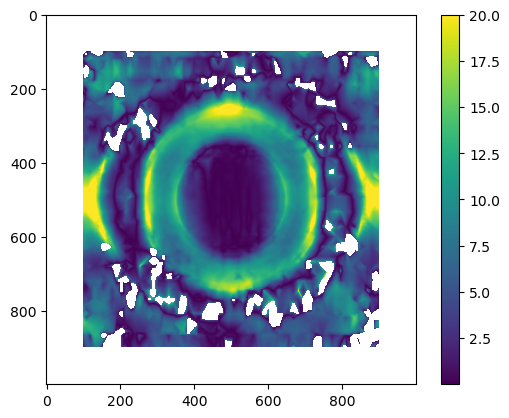

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log10
  """


In [ ]:
imshow(np.abs(10*np.log10(Z_dat)-10*np.log10(Z**2)), vmax = 20)
colorbar()
show()

imshow(np.abs(10*np.log10(rotate_data(27))-10*np.log10(Z**2)), extent=(-40,40,-40,40), vmax = 20)
colorbar()


In [499]:
def rotate_data_general(angle, zdat_lin):
    Xrot, Yrot = rotate((0,0), (X,Y) , angle*np.pi/180)
    Z_dat_rot = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (Xrot,Yrot), method='linear')
    return(Z_dat_rot)

def objective_function2(angle, Z_dat, zdat_lin):
    rotated_map = rotate_data_general(angle, zdat_lin)
    residual = np.log10(rotated_map) - np.log10(Z_dat)
    return np.nanmean(np.abs(residual)**2)

for freq in [450,500,550,600]:
    copoldir = 'E'
    pols = E_pols
    f_intern = 0 # only one frequency per file, this is always 0

    find = good_freqs[find_ind_from_freq(freq)] 

    picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
    with open(picklefile, 'rb') as inp:
        ptest = pickle.load(inp)

    chind = 0 # could change
    zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
    valid_mask = ~np.isnan(zdat_lin)


    Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')

    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)
    
    
    
    best_angle = None
    min_residual = float('inf')

    for angle in range(angle_bounds[0][0], angle_bounds[0][1] + 1, 1):
        angle = min(angle, angle_bounds[0][1])  # Ensure the angle is within bounds
        residual = objective_function2(angle, Z**2, zdat_lin)
        if residual < min_residual:
            min_residual = residual
            best_angle = angle
    print("Optimized Rotation Angle ", freq, 'MHz: ', best_angle)


/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in log10
  


Optimized Rotation Angle  450 MHz:  -45
Optimized Rotation Angle  500 MHz:  -10
Optimized Rotation Angle  550 MHz:  -12
Optimized Rotation Angle  600 MHz:  44


Ok.. above angles solved for are all over the place... depending on whether you fit in log or linear space, whether you square or dont square sims (ie V vs Power which im not 100% positive about)

In [498]:
# put the steps here in a pres to run by drone group tmw

In [501]:
def rotate_data_general(angle, zdat_lin):
    Xrot, Yrot = rotate((0,0), (X,Y) , angle*np.pi/180)
    Z_dat_rot = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (Xrot,Yrot), method='linear')
    return(Z_dat_rot)

# try to find angle at which these two align

def objective_function(angle, Z_dat):
    rotated_map = rotate_data(angle)
    residual = (rotated_map) - (Z_dat)
    return np.nanmean(np.abs(residual)**2)

def objective_function2(angle, Z_dat, zdat_lin):
    rotated_map = rotate_data_general(angle, zdat_lin)
    residual = np.log10(rotated_map) - np.log10(Z_dat)
    return np.nanmean(np.abs(residual)**2)

for freq in [450,500,550,600]:
    copoldir = 'E'
    pols = E_pols
    f_intern = 0 # only one frequency per file, this is always 0

    find = good_freqs[find_ind_from_freq(freq)] 

    picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
    with open(picklefile, 'rb') as inp:
        ptest = pickle.load(inp)

    chind = 0 # could change
    zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
    valid_mask = ~np.isnan(zdat_lin)


    Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')

    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)
    
    
    
    best_angle = None
    min_residual = float('inf')

    for angle in range(angle_bounds[0][0], angle_bounds[0][1] + 1, 1):
        angle = min(angle, angle_bounds[0][1])  # Ensure the angle is within bounds
        residual = objective_function2(angle, Z_dat, zdat_lin)
        if residual < min_residual:
            min_residual = residual
            best_angle = angle
    print("Optimized Rotation Angle ", freq, 'MHz: ', best_angle)


/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in log10
  


Optimized Rotation Angle  450 MHz:  0
Optimized Rotation Angle  500 MHz:  0
Optimized Rotation Angle  550 MHz:  0
Optimized Rotation Angle  600 MHz:  0


# Fit in linear coordinates

In [528]:
def rotate_data_general(angle, zdat_lin):
    Xrot, Yrot = rotate((0,0), (X,Y) , angle*np.pi/180)
    Z_dat_rot = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (Xrot,Yrot), method='linear')
    return(Z_dat_rot)

def objective_function2(angle, Z_dat, zdat_lin):
    rotated_map = rotate_data_general(angle, zdat_lin)
    residual = np.log10(rotated_map) - np.log10(Z_dat)
    return np.nanmean(np.abs(residual)**2)

# Initial guess for the rotation angle
initial_angle = 10
angle_bounds = [(-45, 45)]
options = {'ftol': 1}

chisqrd = {}
for freq in [450,500,550,600]:
    copoldir = 'E'
    pols = E_pols
    f_intern = 0 # only one frequency per file, this is always 0

    find = good_freqs[find_ind_from_freq(freq)] 

    picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
    with open(picklefile, 'rb') as inp:
        ptest = pickle.load(inp)

    chind = 0 # could change
    zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
    valid_mask = ~np.isnan(zdat_lin)


    Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')

    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)
    
    
    
    best_angle = None
    min_residual = float('inf')
    residuals = []
    
    for angle in range(angle_bounds[0][0], angle_bounds[0][1] + 1, 1):
        angle = min(angle, angle_bounds[0][1])  # Ensure the angle is within bounds
        residual = objective_function(angle, Z**2)
        residuals.append(residual)
        if residual < min_residual:
            min_residual = residual
            best_angle = angle
    chisqrd[freq] = residuals
    print("Optimized Rotation Angle ", freq, 'MHz: ', best_angle)


Optimized Rotation Angle  450 MHz:  27
Optimized Rotation Angle  500 MHz:  45
Optimized Rotation Angle  550 MHz:  17
Optimized Rotation Angle  600 MHz:  17


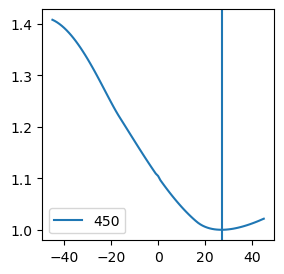

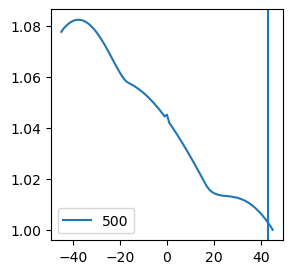

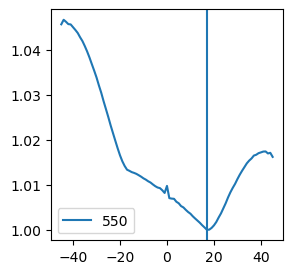

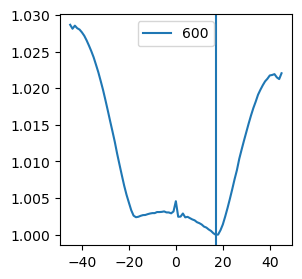

In [620]:
angs = np.arange(angle_bounds[0][0], angle_bounds[0][1] + 1, 1)

for freq in [450,500,550,600]:
    figure(figsize=(3, 3))  # Adjust the figure size as needed
    plot(angs, chisqrd[freq]/np.min(chisqrd[freq]), label =freq)
    minang = angs[chisqrd[freq].index(np.min(chisqrd[freq][:-2]))]
    axvline(minang)
    legend()
    show()

In [537]:
angs[chisqrd[freq].index(np.min(chisqrd[freq]))]

17

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:45: RuntimeWarning: invalid value encountered in log


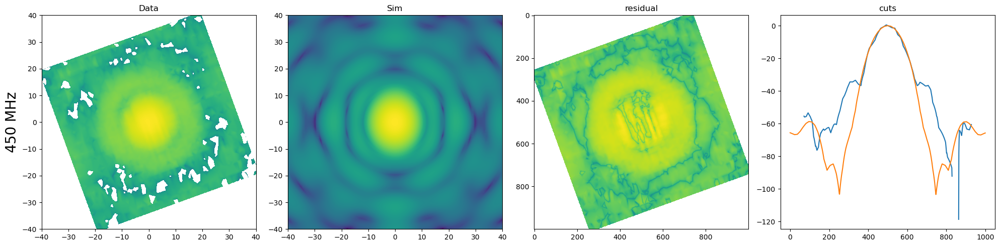

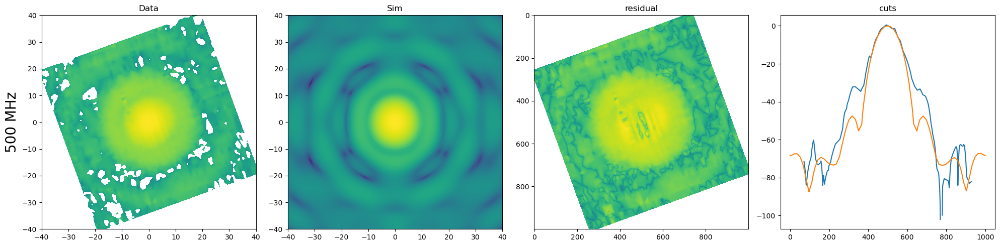

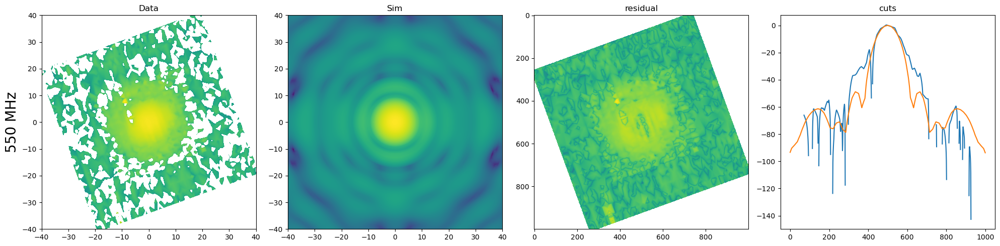

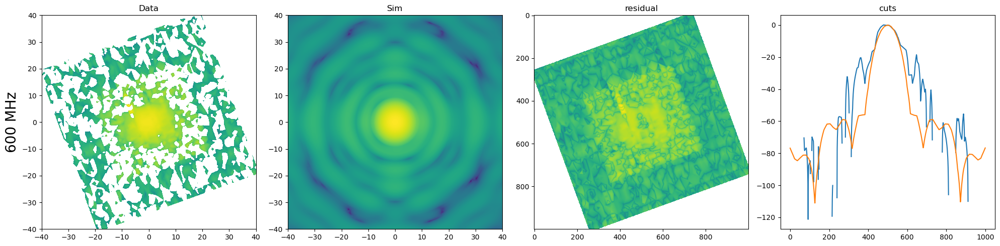

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:57: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:66: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in log


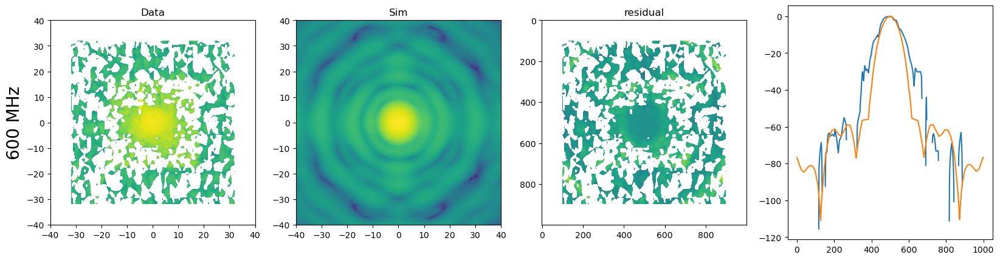

In [546]:
rotangle = 20


for freq in [450,500,550,600]:
    copoldir = 'E'
    pols = E_pols
    f_intern = 0 # only one frequency per file, this is always 0

    find = good_freqs[find_ind_from_freq(freq)] 

    picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
    with open(picklefile, 'rb') as inp:
        ptest = pickle.load(inp)

    chind = 0 # could change
    zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
    valid_mask = ~np.isnan(zdat_lin)


    Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')

    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)

    #plot
    figure(figsize=(20, 5))  # Adjust the figure size as needed
    subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(rotate_data(rotangle)), extent=(-40,40,-40,40))
    title('Data')
    ylabel(str(freq)+' MHz', fontsize = 20)

    subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z), extent=(-40,40,-40,40))
    title('Sim')

    subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(np.abs(rotate_data(rotangle)-Z**2)))
    title('residual')

    subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
    plot(10*np.log(rotate_data(rotangle)[500,:]))
    #     plot(10*np.log(Z[:,500][::-1]**2))
    plot(10*np.log(Z[:,500][::-1]**2))
    #     plot(10*np.log(Z[500,:]))

    title('cuts')

    tight_layout() 
    show()

figure(figsize=(20, 5))  # Adjust the figure size as needed
subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z_dat), extent=(-40,40,-40,40))
title('Data')
ylabel(str(freq)+' MHz', fontsize = 20)

subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z), extent=(-40,40,-40,40))
title('Sim')

subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z_dat)-10*np.log10(Z**2))
title('residual')

subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
plot(10*np.log(Z_dat[500,:]))
#     plot(10*np.log(Z[:,500][::-1]**2))
plot(10*np.log(Z[:,500][::-1]**2))

# try redoing interpolation.. 

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: invalid value encountered in log10


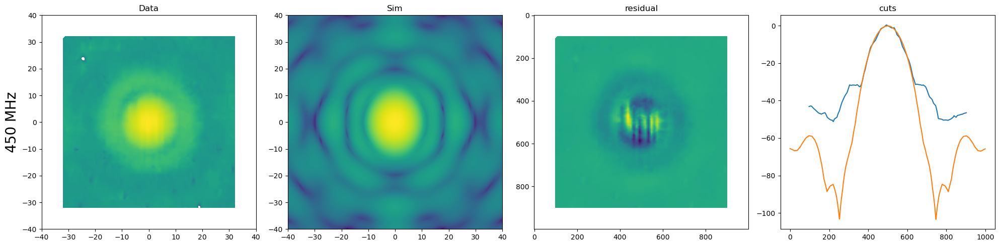

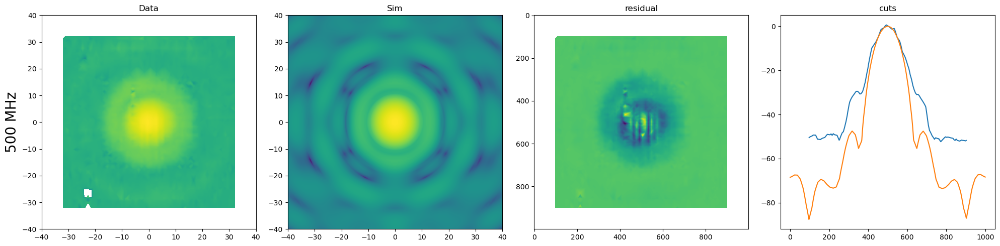

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:52: RuntimeWarning: invalid value encountered in log


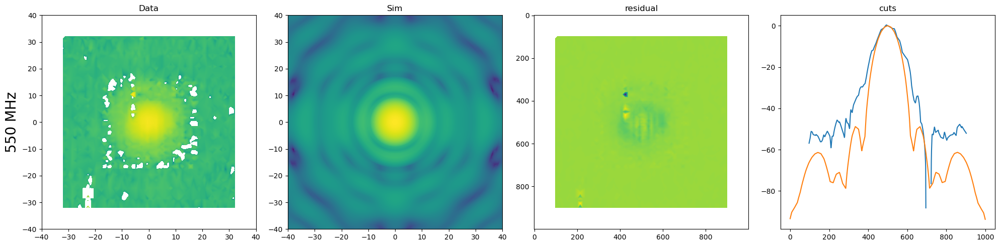

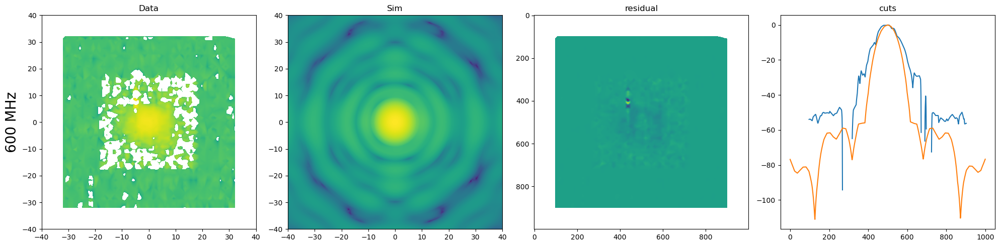

In [572]:
# read data in one place, test that it looks right for 450MHz

#adding 0.005 to make majority of values oscillating about 0 positive without introducing big erros

freq = 450

for freq in [450,500,550,600]:
    copoldir = 'E'
    pols = E_pols
    f_intern = 0 # only one frequency per file, this is always 0

    find = good_freqs[find_ind_from_freq(freq)] 

    picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
    with open(picklefile, 'rb') as inp:
        ptest = pickle.load(inp)

    chind = 0 # could change
    zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
    valid_mask = ~np.isnan(zdat_lin)


    Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), \
                     zdat_lin[valid_mask], (X,Y), method='linear')+0.005

    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)

    residual = Z.transpose()**2-Z_dat


    #plot
    figure(figsize=(20, 5))  # Adjust the figure size as needed
    subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z_dat), extent=(-40,40,-40,40))
    title('Data')
    ylabel(str(freq)+' MHz', fontsize = 20)

    subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z), extent=(-40,40,-40,40))
    title('Sim')

    subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
    imshow(residual)
    title('residual')
    
    subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
    plot(10*np.log(Z_dat[500,:]))
    plot(10*np.log(Z[:,500][::-1]**2))
#     plot(10*np.log(Z[500,:]))

    title('cuts')

    tight_layout() 
    show()

(-0.01, 0.01)

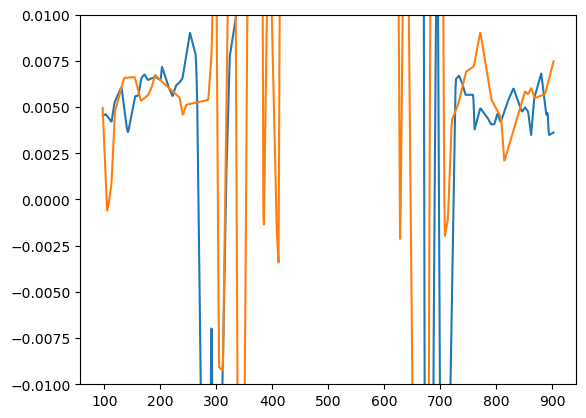

In [597]:
plot(Z_dat[500,:])
plot(Z_dat[:, 500])
ylim(-0.01, 0.01)
#what is cause of negative numbers... 

Q: what is meaning of negative number in this data? is it bc background is normalized? shouldnt all values be positive bc we are essentially computing a count number..? 

A: (I think) bc procedure involves differencing off of one flight, several will wind up with negative values.. 


/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in log10
  """Entry point for launching an IPython kernel.


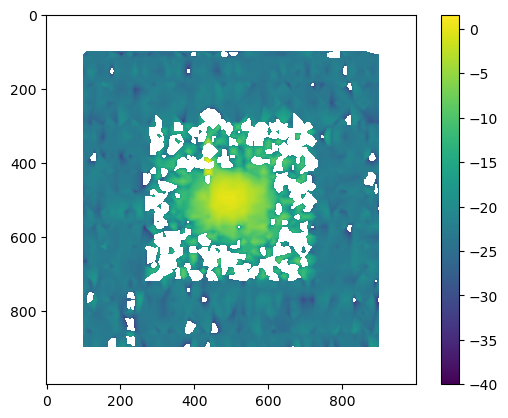

In [618]:
imshow(10*np.log10((Z_dat)), vmin = -40)
colorbar()
show()



/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in log
  """Entry point for launching an IPython kernel.
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in log
  
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


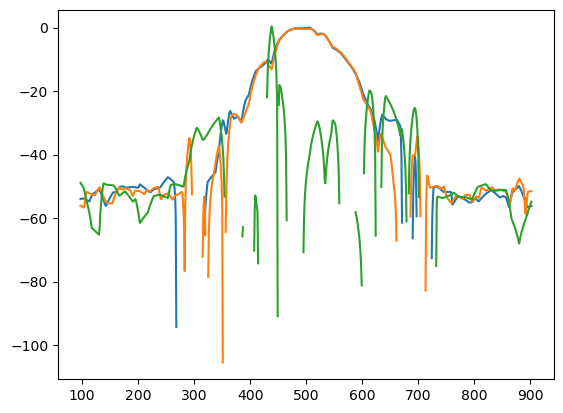

In [615]:
plot(10*np.log(Z_dat[500,:]))
plot(10*np.log(Z_dat[488,:]))
plot(10*np.log(Z_dat[400,:]))


In [619]:
# why do 1D cuts look different floor values than imshow? 

# Goals for tomorrow:
1. 

2. make sure sims look consistent with what I used to show
    - ?? 

3. Sketch plots for sims / 360 degree rotations

4. outline text sims / 360 degree rotations 
    

  

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:45: RuntimeWarning: invalid value encountered in log


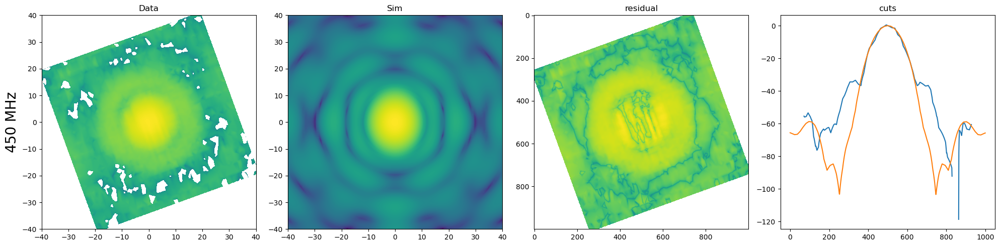

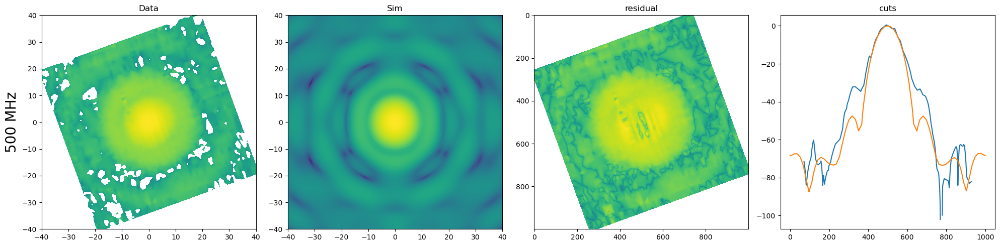

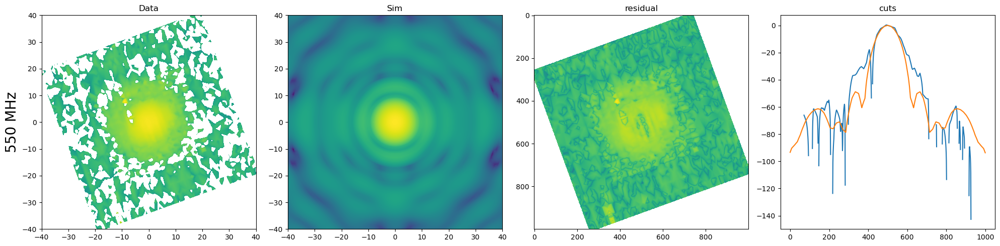

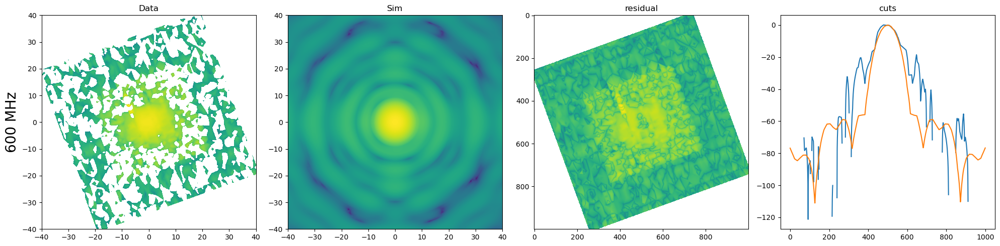

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:57: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:66: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in log


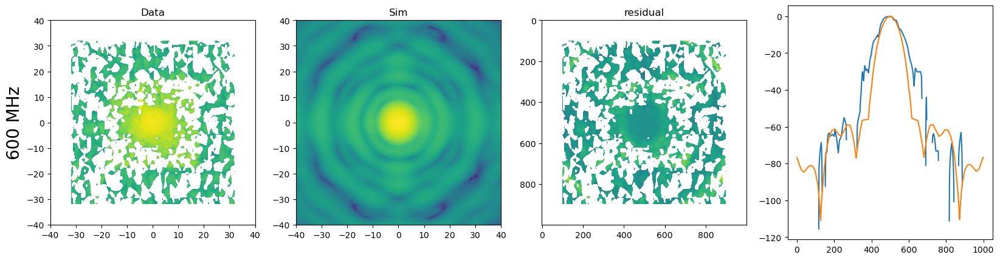

In [626]:
rotangle = 20


for freq in [450,500,550,600]:
    copoldir = 'E'
    pols = E_pols
    f_intern = 0 # only one frequency per file, this is always 0

    find = good_freqs[find_ind_from_freq(freq)] 

    picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
    with open(picklefile, 'rb') as inp:
        ptest = pickle.load(inp)

    chind = 0 # could change
    zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
    valid_mask = ~np.isnan(zdat_lin)


    Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')

    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)

    #plot
    figure(figsize=(20, 5))  # Adjust the figure size as needed
    subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(rotate_data(rotangle)), extent=(-40,40,-40,40))
    title('Data')
    ylabel(str(freq)+' MHz', fontsize = 20)

    subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z), extent=(-40,40,-40,40))
    title('Sim')

    subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(np.abs(rotate_data(rotangle)-Z**2)))
    title('residual')

    subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
    plot(10*np.log(rotate_data(rotangle)[500,:]))
    #     plot(10*np.log(Z[:,500][::-1]**2))
    plot(10*np.log(Z[:,500][::-1]**2))
    #     plot(10*np.log(Z[500,:]))

    title('cuts')

    tight_layout() 
    show()

figure(figsize=(20, 5))  # Adjust the figure size as needed
subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z_dat), extent=(-40,40,-40,40))
title('Data')
ylabel(str(freq)+' MHz', fontsize = 20)

subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z), extent=(-40,40,-40,40))
title('Sim')

subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z_dat)-10*np.log10(Z**2))
title('residual')

subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
plot(10*np.log(Z_dat[500,:]))
#     plot(10*np.log(Z[:,500][::-1]**2))
plot(10*np.log(Z[:,500][::-1]**2))

# Latest Data

In [639]:
fitdir='/hirax/GBO_Analysis_Outputs/main_beam_fits/'
ymldir = '/hirax/GBO_Analysis_Outputs/concat_config_files/'
pckldir = '/hirax/GBO_Analysis_Outputs/flight_pickles/'
ampdir = '/hirax/GBO_Analysis_Outputs/amplitude_corrections/'
beamdir = '/hirax/GBO_Analysis_Outputs/2023_SpringSummer_products/beam_pickles/' #/hirax/GBO_Analysis_Outputs/beam_pickles/'
beamdir = '/hirax/GBO_Analysis_Outputs/beam_pickles/'
# beamdir = '/hirax/GBO_Analysis_Outputs/beam_pickles_polar/'


In [640]:
def get_flightinfo(fly):
    for fi in range(0,len(documents["flight_info"]["flights"])):
        if fly == flights[fi]: f = fi
    
    if polarn[f]=='N':
        pols = N_pols
        cpols = E_pols
    else:
        pols = E_pols
        cpols = N_pols
    return polarn[f], pols, cpols, attns[f], f

def get_beam_diff(beam2, beam1,n):
    return beam2[:,:] - n*beam1[:,:]

def get_stat(new_d,whstat='stddev'): # default is stddev
    diff_flat = np.ndarray.flatten(new_d)
    if whstat=='stddev':
        stat = np.nanstd(diff_flat)
    elif whstat=='median':
        # compute median
        stat = np.abs(np.nanmedian(diff_flat))
    elif whstat=='sum':
        stat = np.nanmean(np.abs(diff_flat))
    elif whstat=='mednoabs':
        stat = np.nanmedian(diff_flat)
    return stat

def get_slice(beam,Z,val,ax='x'):
    # this gradually increases the tolerance until it finds something
    tol = abs(beam.x_centers_grid[0,1,0] - beam.x_centers_grid[0,0,0])/1.5
    N = len(beam.x_centers_grid[0,:,0])
    ok = True
    while(ok):
        if ax=='x':
            col = np.where((beam.x_centers_grid[0,:,0] < val+tol) & (beam.x_centers_grid[0,:,0] > val-tol))[0][0]
            n = np.count_nonzero(np.isfinite(Z)) #count number of 'good' data
            if n > 10: ok = False
            else: ok = True
        if ax=='y':
            col = np.where((beam.y_centers_grid[:,0,0] < val+tol) & (beam.y_centers_grid[:,0,0] > val-tol))[0][0]
            n = np.count_nonzero(np.isfinite(Z)) #count number of 'good' data
            if n > 10: ok = False
            else: ok = True
        tol+=3
        if tol > 30: ok = False
    return col

def get_slice_anyin(LX,LY,val,ax='x'):
    tol = abs(LX[0,1] - LX[0,0])/1.5
    if ax=='x':
        col = np.where((LX[0,:] < val+tol) & (LX[0,:] > val-tol))[0][0]
    if ax=='y':
        col = np.where((LY[:,0] < val+tol) & (LY[:,0] > val-tol))[0][0]
    return col


def get_concatlist(flights):
    #for i, fly in enumerate(flights):
#     pickle_directory='/hirax/GBO_Analysis_Outputs/flight_pickles/'
    pickle_directory='/hirax/GBO_Analysis_Outputs/beam_pickles_polar'
    concytest=[glob.glob(pickle_directory+'*'+fly+'*')[0] for fly in flights]
    return concytest

In [641]:
with open('/hirax/GBO_Analysis_Outputs/GBO_flights_forscripts.yaml', 'r') as fff:
    documents = yaml.safe_load(fff)
flights = documents["flight_info"]["flights"]
N_pols = documents["flag_info"]["N_pols"]
E_pols = documents["flag_info"]["E_pols"]
polarn = documents["flight_info"]["pols"]
attns = documents["flight_info"]["attns"]
masks = documents["flight_info"]["masks"]
good_freqs = documents["freq_info"]["good_freqs"]

pcklarr=np.sort(os.listdir(pckldir))
gfitarr=np.sort(os.listdir(fitdir))
amparr=np.sort(os.listdir(ampdir))
# print(gfitarr,amparr)


# SLICE DEFAULTS # 
sliw = 10 # This defines slices for (some) plots
sz = 80 # use this to set the size of the Xargs and Yargs for beammapping, usually 80 or 50

# PLOTTING DEFAULT # 
cmap = matplotlib.cm.get_cmap('gnuplot2')
norm = matplotlib.colors.Normalize(vmin=-25, vmax=25)
sfig = False

Npolflights = ['618','619','625','646','647','533','536']
Epolflights = ['620','648','649','535']

In [642]:
find = good_freqs[-38]
np.linspace(800,400,1024)[find]

450.0488758553275

In [643]:
copoldir = 'N'
pols = N_pols
f_intern = 0 # only one frequency per file, this is always 0

# find = good_freqs[-1]
# picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)
 

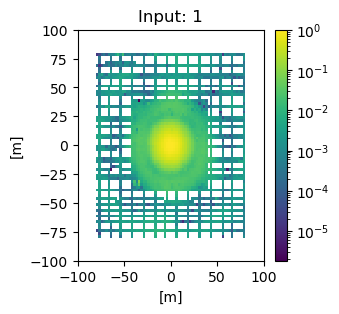

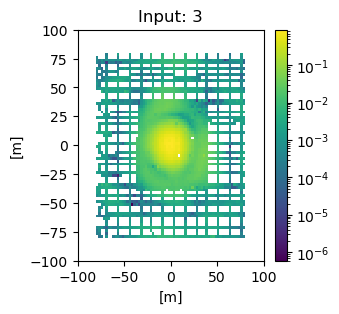

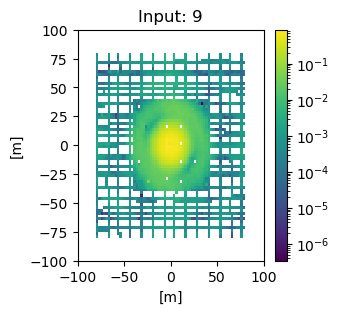

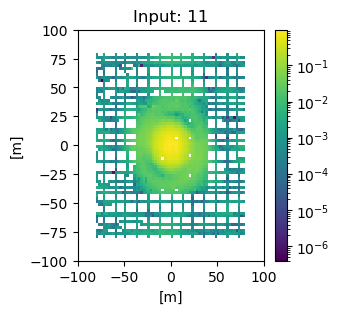

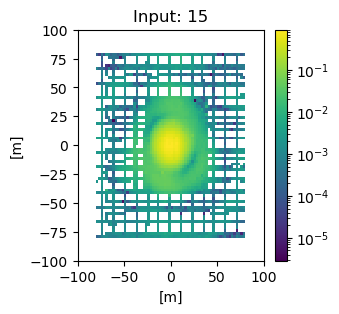

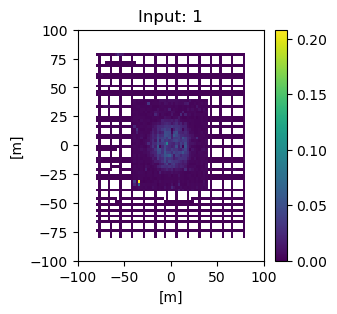

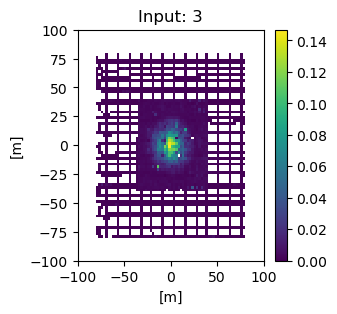

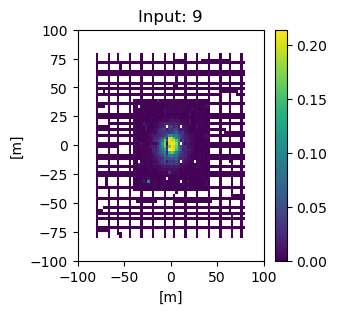

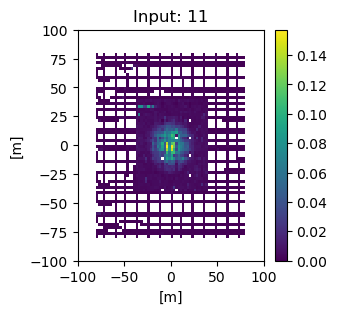

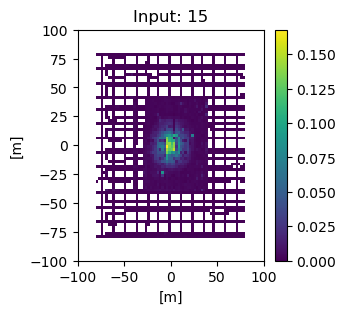

In [646]:
sz = 100

# set which pol:
copoldir = 'N'
pols = N_pols
f_intern = 0 # only one frequency per file, this is always 0

find = good_freqs[-38] #450MHz
picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)
    
# Plot maps and variances

for i,chind in enumerate(pols):
    fig = plt.figure(figsize=(3,3))
    plt.pcolormesh(ptest.x_centers_grid[:,:,chind],ptest.y_centers_grid[:,:,chind],
               np.abs(ptest.V_LC_operation[:,:,0,chind]),cmap=cm.viridis,norm=LogNorm())#,edgecolors='k')
    plt.xlim(-1*sz,sz)
    plt.ylim(-1*sz,sz)
    plt.xlabel('[m]')
    plt.ylabel('[m]')
    plt.title('Input: '+str(chind))
    plt.colorbar()
    plt.show()

for i,chind in enumerate(pols):
    fig = plt.figure(figsize=(3,3))
    plt.pcolormesh(ptest.x_centers_grid[:,:,chind],ptest.y_centers_grid[:,:,chind],
               ptest.V_LC_operation_err[:,:,0,chind],cmap=cm.viridis)#,edgecolors='k')
    plt.xlim(-1*sz,sz)
    plt.ylim(-1*sz,sz)
    plt.xlabel('[m]')
    plt.ylabel('[m]')
    plt.title('Input: '+str(chind))
    plt.colorbar()
    plt.show()
    
    


In [663]:
ccm = cm.magma # use magma for color maps
fsz = 16 # fontsize for labels and legends

def get_polar_slice(theta,phi,val=0.0): # assume val in angle
    
    tol = abs(theta[1,0] - theta[0,0])/1.5
    N = len(theta[:,0]) #figure out the importance of this 
    #ok = True
    #while(ok):
    sliceIndex1 = np.where(
            (theta[:,0] < (val + tol)) & 
            (theta[:,0] > (val - tol)))[0][0]
    sliceIndex2 = np.where(
            (theta[:,0] < (np.pi + val + tol)) & 
            (theta[:,0] > (np.pi + val - tol)))[0][0]
    return sliceIndex1, sliceIndex2

In [664]:
polbeamdir = '/hirax/GBO_Analysis_Outputs/beam_pickles_polar/'

copoldir = 'N'
pols = N_pols
f_intern = 0 # only one frequency per file, this is always 0

# find = good_freqs[-1]
# picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)
 

In [665]:

# # set which pol:
# copoldir = 'N'
# pols = N_pols
# f_intern = 0 # only one frequency per file, this is always 0

# find = good_freqs[-38] #450MHz
# picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
# with open(picklefile, 'rb') as inp:
#     ptest = pickle.load(inp)
    
# # Plot maps and variances

# for i,chind in enumerate(pols):
#     fig = plt.figure(figsize=(3,3))
#     plt.pcolormesh(ptest.x_centers_grid[:,:,chind],ptest.y_centers_grid[:,:,chind],
#                np.abs(ptest.V_LC_operation[:,:,0,chind]),cmap=cm.viridis,norm=LogNorm())#,edgecolors='k')
#     plt.xlim(-1*sz,sz)
#     plt.ylim(-1*sz,sz)
#     plt.xlabel('[m]')
#     plt.ylabel('[m]')
#     plt.title('Input: '+str(chind))
#     plt.colorbar()
#     plt.show()

# for i,chind in enumerate(pols):
#     fig = plt.figure(figsize=(3,3))
#     plt.pcolormesh(ptest.x_centers_grid[:,:,chind],ptest.y_centers_grid[:,:,chind],
#                ptest.V_LC_operation_err[:,:,0,chind],cmap=cm.viridis)#,edgecolors='k')
#     plt.xlim(-1*sz,sz)
#     plt.ylim(-1*sz,sz)
#     plt.xlabel('[m]')
#     plt.ylabel('[m]')
#     plt.title('Input: '+str(chind))
#     plt.colorbar()
#     plt.show()
    
    


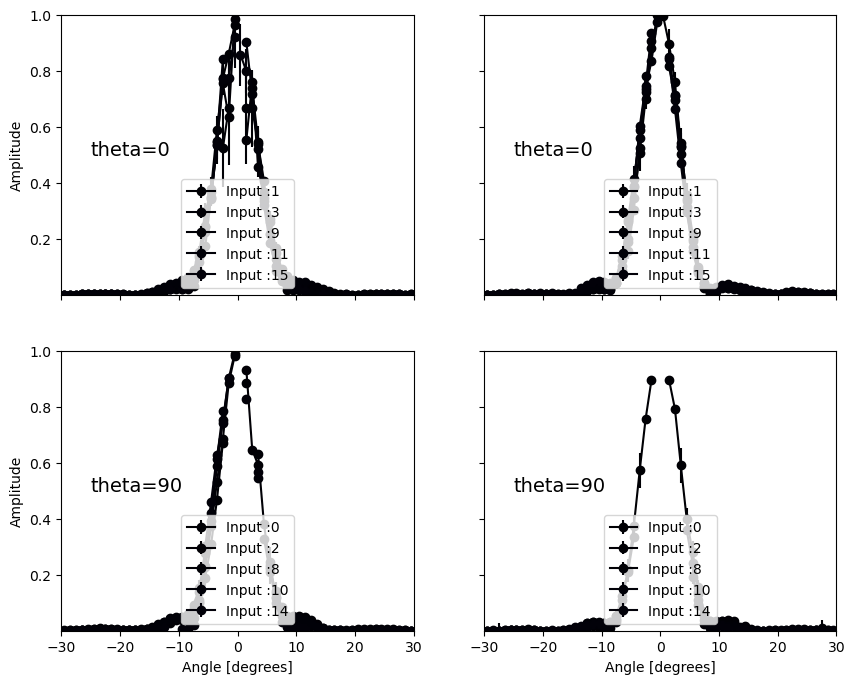

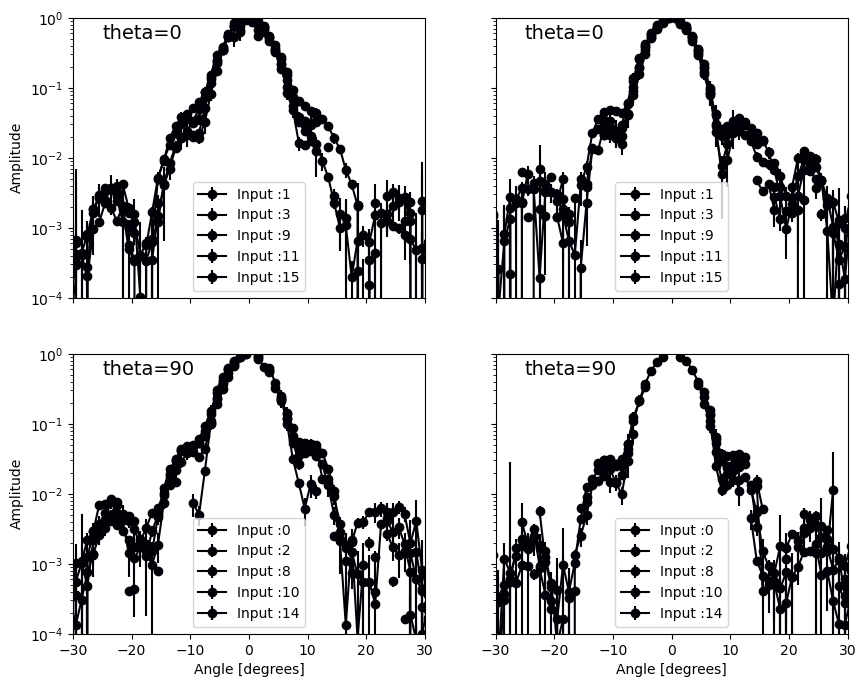

In [666]:
## Slice plots of co-added beams, including error bars ####

colorz = pu.cm_to_discrete(ccm, 5)

# set which pol:
copoldir = 'N'
pols = N_pols
chind = pols[0]


picklefile = polbeamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)

chind = pols[0]
col1,col2 = get_polar_slice(ptest.d0_centers_grid[:,:,chind],
                          ptest.d1_centers_grid[:,:,chind],0.0)

col1_90,col2_90 = get_polar_slice(ptest.d0_centers_grid[:,:,chind],
                          ptest.d1_centers_grid[:,:,chind],np.pi/2.)


fig,axs = plt.subplots(2, 2, sharex=True,sharey=True,figsize=(10,8))
for i,chind in enumerate(N_pols):  
    axs[0,0].errorbar(np.degrees(ptest.d1_centers_grid[col1,:,chind]),
                    ptest.V_LC_operation[col1,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1,:,0,chind],marker='o',
             color=colorz[i],label='Input :'+str(chind))
    axs[0,0].errorbar(-1.0*np.degrees(ptest.d1_centers_grid[col2,:,chind]),
                    ptest.V_LC_operation[col2,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1,:,0,chind],marker='o',
             color=colorz[i])
    axs[0,1].errorbar(np.degrees(ptest.d1_centers_grid[col1_90,:,chind]),
                    ptest.V_LC_operation[col1_90,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1_90,:,0,chind],marker='o',
             color=colorz[i],label='Input :'+str(chind))
    axs[0,1].errorbar(-1.0*np.degrees(ptest.d1_centers_grid[col2_90,:,chind]),
                    ptest.V_LC_operation[col2_90,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1_90,:,0,chind],marker='o',
             color=colorz[i])
    

copoldir = 'E'
pols = E_pols
chind = pols[0]
picklefile = polbeamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)
    
for i,chind in enumerate(E_pols):
    axs[1,0].errorbar(np.degrees(ptest.d1_centers_grid[col1,:,chind]),
                    ptest.V_LC_operation[col1,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1,:,0,chind], marker='o',
                    color=colorz[i],label='Input :'+str(chind))
    axs[1,0].errorbar(-1.0*np.degrees(ptest.d1_centers_grid[col2,:,chind]),
                    ptest.V_LC_operation[col2,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1,:,0,chind],marker='o',
                     color=colorz[i])
    axs[1,1].errorbar(np.degrees(ptest.d1_centers_grid[col1_90,:,chind]),
                    ptest.V_LC_operation[col1_90,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1_90,:,0,chind],marker='o',
                    color=colorz[i],label='Input :'+str(chind))
    axs[1,1].errorbar(-1.0*np.degrees(ptest.d1_centers_grid[col2_90,:,chind]),
                    ptest.V_LC_operation[col2_90,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1_90,:,0,chind],marker='o',
                     color=colorz[i])
    
axs[1,0].set_xlabel('Angle [degrees]')
axs[1,1].set_xlabel('Angle [degrees]')
axs[0,0].set_ylabel('Amplitude')
axs[1,0].set_ylabel('Amplitude')
axs[0,0].legend(loc='lower center')
axs[1,0].legend(loc='lower center')
axs[0,1].legend(loc='lower center')
axs[1,1].legend(loc='lower center')
axs[0,0].text(-25,0.5,'theta=0',fontsize=14)
axs[0,1].text(-25,0.5,'theta=0',fontsize=14)
axs[1,0].text(-25,0.5,'theta=90',fontsize=14)
axs[1,1].text(-25,0.5,'theta=90',fontsize=14)
axs[0,0].set_xlim(-30,30)
axs[0,0].set_ylim(1E-4,1)
plt.show()



# set which pol:
copoldir = 'N'
pols = N_pols
chind = pols[0]

picklefile = polbeamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)

chind = pols[0]
col1,col2 = get_polar_slice(ptest.d0_centers_grid[:,:,chind],
                          ptest.d1_centers_grid[:,:,chind],0.0)

col1_90,col2_90 = get_polar_slice(ptest.d0_centers_grid[:,:,chind],
                          ptest.d1_centers_grid[:,:,chind],np.pi/2.)


fig,axs = plt.subplots(2, 2, sharex=True,sharey=True,figsize=(10,8))
for i,chind in enumerate(N_pols):  
    axs[0,0].errorbar(np.degrees(ptest.d1_centers_grid[col1,:,chind]),
                    ptest.V_LC_operation[col1,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1,:,0,chind],marker='o',
             color=colorz[i],label='Input :'+str(chind))
    axs[0,0].errorbar(-1.0*np.degrees(ptest.d1_centers_grid[col2,:,chind]),
                    ptest.V_LC_operation[col2,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1,:,0,chind],marker='o',
             color=colorz[i])
    axs[0,1].errorbar(np.degrees(ptest.d1_centers_grid[col1_90,:,chind]),
                    ptest.V_LC_operation[col1_90,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1_90,:,0,chind],marker='o',
             color=colorz[i],label='Input :'+str(chind))
    axs[0,1].errorbar(-1.0*np.degrees(ptest.d1_centers_grid[col2_90,:,chind]),
                    ptest.V_LC_operation[col2_90,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1_90,:,0,chind],marker='o',
             color=colorz[i])
    

copoldir = 'E'
pols = E_pols
chind = pols[0]
picklefile = polbeamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)
    
for i,chind in enumerate(E_pols):
    axs[1,0].errorbar(np.degrees(ptest.d1_centers_grid[col1,:,chind]),
                    ptest.V_LC_operation[col1,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1,:,0,chind], marker='o',
                    color=colorz[i],label='Input :'+str(chind))
    axs[1,0].errorbar(-1.0*np.degrees(ptest.d1_centers_grid[col2,:,chind]),
                    ptest.V_LC_operation[col2,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1,:,0,chind],marker='o',
                     color=colorz[i])
    axs[1,1].errorbar(np.degrees(ptest.d1_centers_grid[col1_90,:,chind]),
                    ptest.V_LC_operation[col1_90,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1_90,:,0,chind],marker='o',
                    color=colorz[i],label='Input :'+str(chind))
    axs[1,1].errorbar(-1.0*np.degrees(ptest.d1_centers_grid[col2_90,:,chind]),
                    ptest.V_LC_operation[col2_90,:,0,chind],
                    yerr=ptest.V_LC_operation_err[col1_90,:,0,chind],marker='o',
                     color=colorz[i])
    
axs[1,0].set_xlabel('Angle [degrees]')
axs[1,1].set_xlabel('Angle [degrees]')
axs[0,0].set_ylabel('Amplitude')
axs[1,0].set_ylabel('Amplitude')
axs[0,0].legend(loc='lower center')
axs[1,0].legend(loc='lower center')
axs[0,1].legend(loc='lower center')
axs[1,1].legend(loc='lower center')
axs[0,0].text(-25,0.5,'theta=0',fontsize=14)
axs[0,1].text(-25,0.5,'theta=0',fontsize=14)
axs[1,0].text(-25,0.5,'theta=90',fontsize=14)
axs[1,1].text(-25,0.5,'theta=90',fontsize=14)
axs[0,0].set_yscale('log')
axs[0,0].set_xlim(-30,30)
axs[0,0].set_ylim(1E-4,1)
plt.show()

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in log10
  app.launch_new_instance()
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:17: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  app.launch_new_instance()
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:30: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.


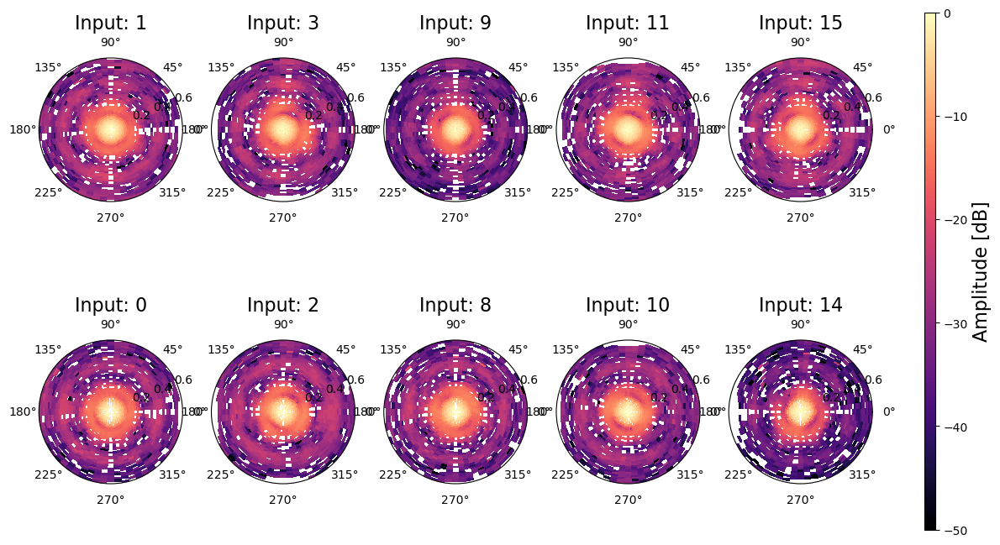

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:55: RuntimeWarning: divide by zero encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:68: RuntimeWarning: divide by zero encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:68: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.


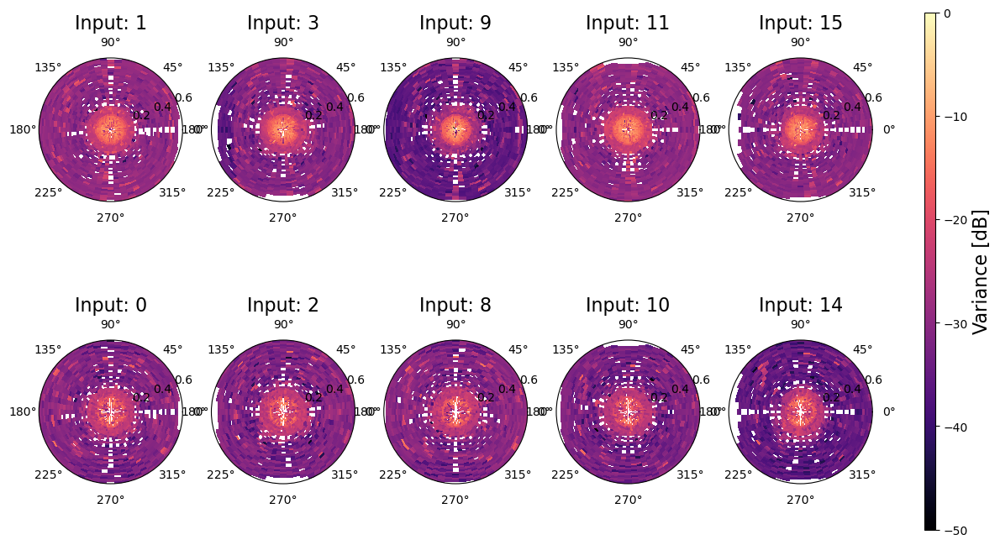

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:93: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:105: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.


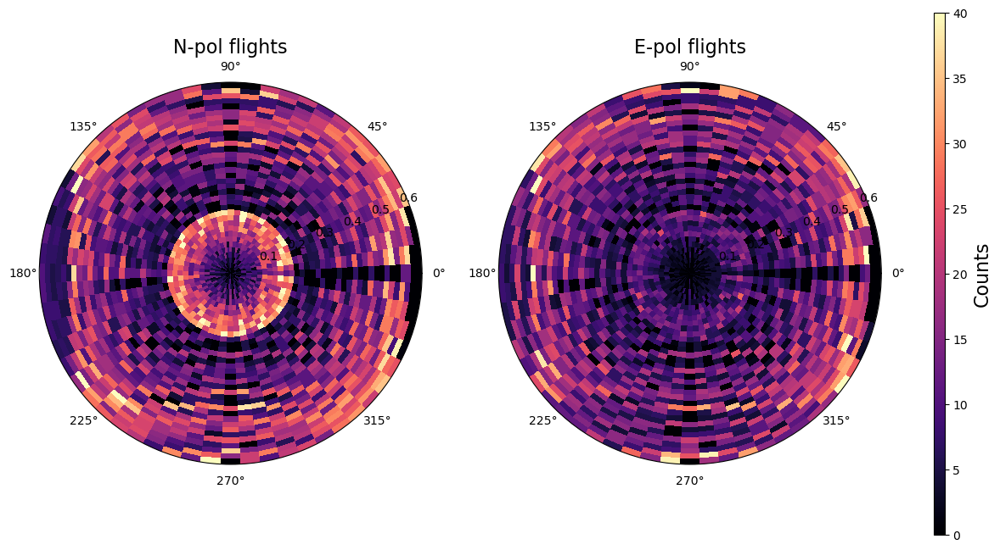

In [667]:
### Polar beam maps at freqind 900, maps and errors ###

fig, axs = plt.subplots(2, 5, subplot_kw=dict(projection="polar"),figsize=(16,8))

# N pols first
copoldir = 'N'
pols = N_pols
find = 900

picklefile = polbeamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)


for i,chind in enumerate(N_pols):
    axs[0, i].pcolormesh(ptest.d0_edges_grid[:,:,chind],ptest.d1_edges_grid[:,:,chind],
                10*np.log10(ptest.V_LC_operation[:,:,0,chind]),cmap=ccm,vmin=-50,vmax=0)
    axs[0, i].set_title('Input: '+str(chind),fontsize=fsz)

copoldir = 'E'
pols = E_pols

picklefile = polbeamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)


for i,chind in enumerate(E_pols):
    im = axs[1, i].pcolormesh(ptest.d0_edges_grid[:,:,chind],ptest.d1_edges_grid[:,:,chind],
                10*np.log10(ptest.V_LC_operation[:,:,0,chind]),cmap=ccm,vmin=-50,vmax=0)
    axs[1, i].set_title('Input: '+str(chind),fontsize=fsz)
    #axs[1, i].colorbar()


cbar=fig.colorbar(im,ax=axs,aspect=50)
cbar.set_label('Amplitude [dB]',fontsize=fsz)
plt.show()

### Polar beam map - errors at freqind 900 ###

fig, axs = plt.subplots(2, 5, subplot_kw=dict(projection="polar"),figsize=(16,8))

# N pols first
copoldir = 'N'
pols = N_pols
find = 900

picklefile = polbeamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)


for i,chind in enumerate(N_pols):
    axs[0, i].pcolormesh(ptest.d0_edges_grid[:,:,chind],ptest.d1_edges_grid[:,:,chind],
                10*np.log10(ptest.V_LC_operation_err[:,:,0,chind]),cmap=ccm,vmin=-50,vmax=0)
    axs[0, i].set_title('Input: '+str(chind),fontsize=fsz)

copoldir = 'E'
pols = E_pols

picklefile = polbeamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)


for i,chind in enumerate(E_pols):
    im = axs[1, i].pcolormesh(ptest.d0_edges_grid[:,:,chind],ptest.d1_edges_grid[:,:,chind],
                10*np.log10(ptest.V_LC_operation_err[:,:,0,chind]),cmap=ccm,vmin=-50,vmax=0)
    axs[1, i].set_title('Input: '+str(chind),fontsize=fsz)
    #axs[1, i].colorbar()


cbar=fig.colorbar(im,ax=axs,aspect=50)
cbar.set_label('Variance [dB]',fontsize=fsz)
plt.show()

## Plot total counts ###

fig, axs = plt.subplots(1,2, subplot_kw=dict(projection="polar"),figsize=(16,8))

# N pols first
copoldir = 'N'
pols = N_pols
find = 900

picklefile = polbeamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)


chind = pols[0]
axs[0].pcolormesh(ptest.d0_edges_grid[:,:,chind],ptest.d1_edges_grid[:,:,chind],
            ptest.V_LC_operation_count[:,:,0,chind],cmap=ccm,vmin=0,vmax=40)
axs[0].set_title('N-pol flights',fontsize=fsz)
copoldir = 'E'
pols = E_pols

picklefile = polbeamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)


chind = pols[0]
im = axs[1].pcolormesh(ptest.d0_edges_grid[:,:,chind],ptest.d1_edges_grid[:,:,chind],
            ptest.V_LC_operation_count[:,:,0,chind],cmap=ccm,vmin=0,vmax=40)
axs[1].set_title('E-pol flights',fontsize=fsz)
cbar=fig.colorbar(im,ax=axs,aspect=50)
cbar.set_label('Counts',fontsize=fsz)

fig.show()


/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in log10
  from ipykernel import kernelapp as app
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  from ipykernel import kernelapp as app
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.


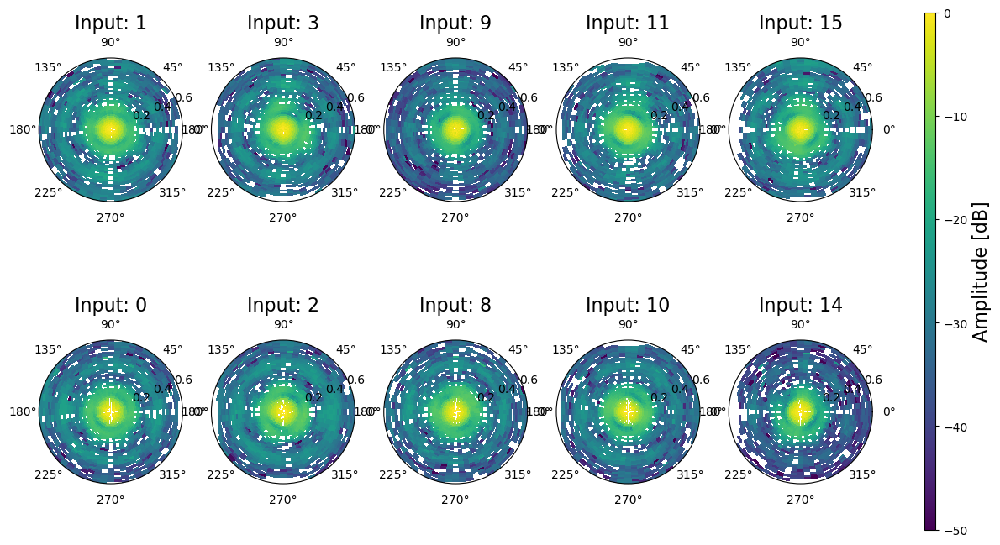

In [672]:

fig, axs = plt.subplots(2, 5, subplot_kw=dict(projection="polar"),figsize=(16,8))

# N pols first
copoldir = 'N'
pols = N_pols
find = 900

picklefile = polbeamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)


for i,chind in enumerate(N_pols):
    axs[0, i].pcolormesh(ptest.d0_edges_grid[:,:,chind],ptest.d1_edges_grid[:,:,chind],
                10*np.log10(ptest.V_LC_operation[:,:,0,chind]),vmin=-50,vmax=0)
    axs[0, i].set_title('Input: '+str(chind),fontsize=fsz)

copoldir = 'E'
pols = E_pols

picklefile = polbeamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
with open(picklefile, 'rb') as inp:
    ptest = pickle.load(inp)


for i,chind in enumerate(E_pols):
    im = axs[1, i].pcolormesh(ptest.d0_edges_grid[:,:,chind],ptest.d1_edges_grid[:,:,chind],
                10*np.log10(ptest.V_LC_operation[:,:,0,chind]),vmin=-50,vmax=0)
    axs[1, i].set_title('Input: '+str(chind),fontsize=fsz)
    #axs[1, i].colorbar()


cbar=fig.colorbar(im,ax=axs,aspect=50)
cbar.set_label('Amplitude [dB]',fontsize=fsz)
plt.show()


In [680]:
r.shape

(61, 37)

In [744]:
# flight polar to cartesian
# theta = ptest.d0_edges_grid[:,:,chind]
# r = ptest.d1_edges_grid[:,:,chind]

# x = np.cos(theta)*r*180/(2*np.pi)
# y = np.sin(theta)*r*180/(2*np.pi)


theta = ptest.d0_edges_grid
r = ptest.d1_edges_grid

x = np.cos(theta)*r*180/(2*np.pi)
y = np.sin(theta)*r*180/(2*np.pi)



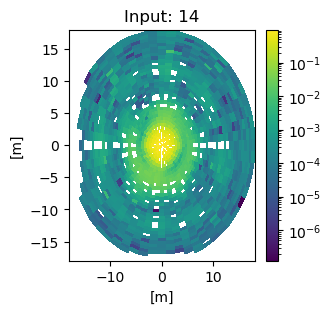

In [796]:
# plot
fig = plt.figure(figsize=(3,3))
plt.pcolormesh(x[:,:,chind],y[:,:,chind],
           np.abs(ptest.V_LC_operation[:,:,0,chind]),cmap=cm.viridis,norm=LogNorm())#,edgecolors='k')
# plt.xlim(-1*sz,sz)
# plt.ylim(-1*sz,sz)
plt.xlabel('[m]')
plt.ylabel('[m]')
plt.title('Input: '+str(chind))
plt.colorbar()
plt.show()


In [787]:
z = np.abs(ptest.V_LC_operation[:,:,0,chind])
print(x[:,:,chind].shape)
print(y[:,:,chind].shape)
print(z.shape)

#how am i able to plot things with different dimensions...
#bc pcolormesh interpolates apparently...but i dont really get this, bc if i change z to be (60,35) it breaks..

(61, 37)
(61, 37)
(60, 36)


In [719]:
r.max()-2*np.pi/10

0.0

In [723]:
r.max()*180/(2*np.pi)

18.0

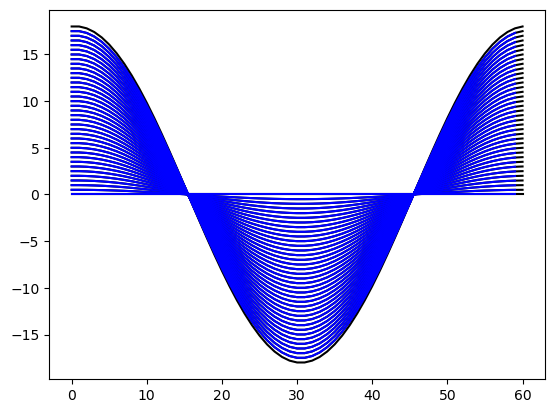

In [788]:
plot(x[:,:,chind], color ='k')
plot(x[:-1,:-1,chind], color ='b')
show()

In [779]:
ptest.V_LC_operation[:,:,0,chind].shape
x[:,:-1,chind].shape

(61, 36)

In [804]:
xdat_lin = x[:-1,:-1,chind].ravel()
ydat_lin = y[:-1,:-1,chind].ravel()
zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
valid_mask = ~np.isnan(zdat_lin)


Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')
# Z_dat = griddata((xdat_lin,ydat_lin), zdat_lin, (X,Y), method='linear')


In [805]:
ptest.V_LC_operation[:,:,0,chind].shape
# x[:,:,chind].shape

(60, 36)

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in log10
  


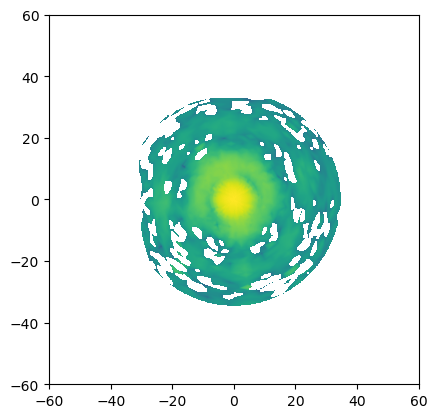

In [806]:
# plot data data at 450MHz
imshow(10*np.log10(Z_dat), extent=(-60,60,-60,60))
show()

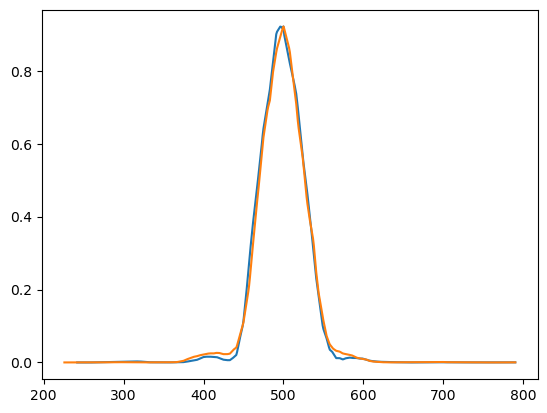

In [807]:
Z_dat.shape

plot(Z_dat[500,:])
plot(Z_dat[:,500])
show()


In [827]:
def file_to_interdata(picklefile, chind):
    with open(picklefile, 'rb') as inp:
        ptest = pickle.load(inp)
    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))

        
        
    theta = ptest.d0_edges_grid
    r = ptest.d1_edges_grid

    x = np.cos(theta)*r*180/(np.pi)
    y = np.sin(theta)*r*180/(np.pi)
   
    xdat_lin = x[:-1,:-1,chind].ravel()
    ydat_lin = y[:-1,:-1,chind].ravel()
    zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
    valid_mask = ~np.isnan(zdat_lin)


    Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')

    return(Z_dat)

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:51: RuntimeWarning: invalid value encountered in log


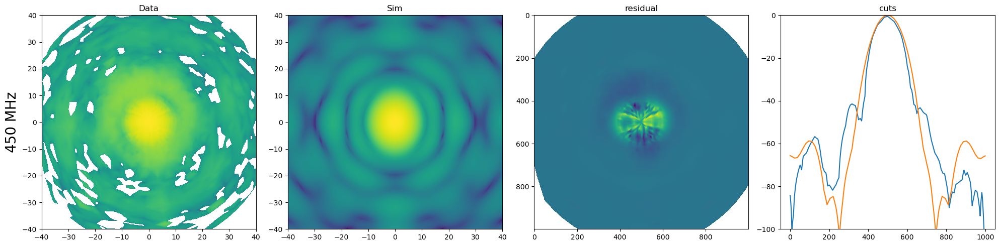

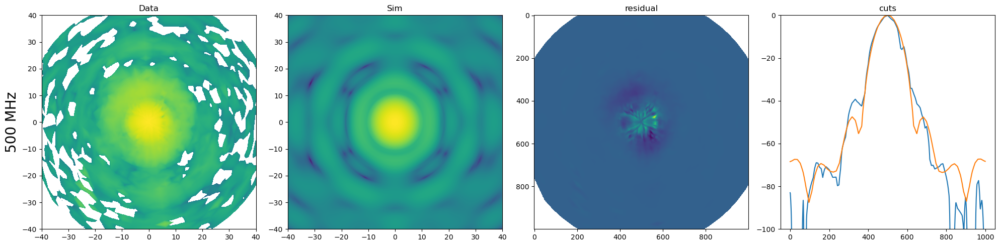

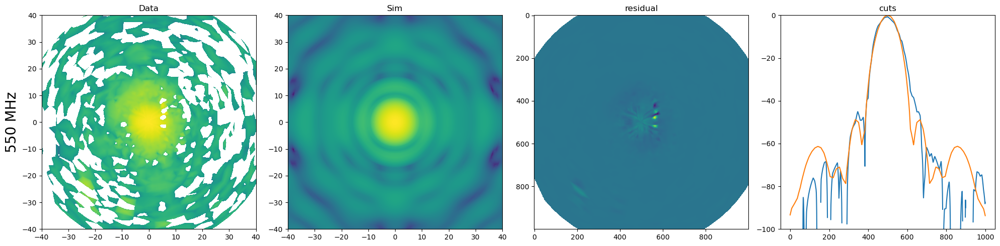

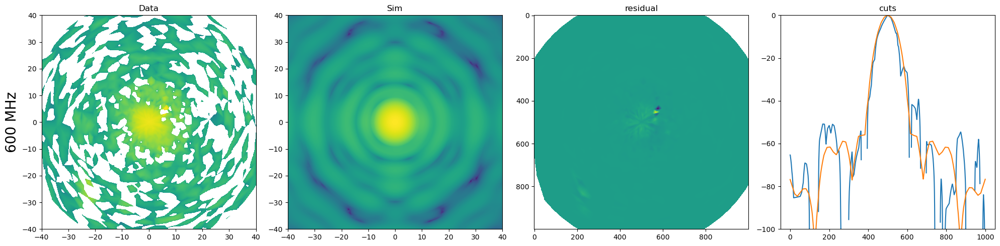

In [823]:
# read data in one place, test that it looks right for 450MHz

freq = 450

for freq in [450,500,550,600]:
    copoldir = 'E'
    pols = E_pols
    f_intern = 0 # only one frequency per file, this is always 0

    find = good_freqs[find_ind_from_freq(freq)] 

    picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
#     with open(picklefile, 'rb') as inp:
#         ptest = pickle.load(inp)

#     chind = 0 # could change
#     zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
#     valid_mask = ~np.isnan(zdat_lin)


#     Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')

    Z_dat = file_to_interdata(picklefile, chind)

    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)

    residual = Z.transpose()**2-Z_dat


    #plot
    figure(figsize=(20, 5))  # Adjust the figure size as needed
    subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z_dat), extent=(-40,40,-40,40))
    title('Data')
    ylabel(str(freq)+' MHz', fontsize = 20)

    subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z), extent=(-40,40,-40,40))
    title('Sim')

    subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
    imshow(residual)
    title('residual')
    
    subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
    plot(10*np.log(Z_dat[500,:]))
#     plot(10*np.log(Z_dat[:, 500]))
    plot(10*np.log(Z[:,500][::-1]**2))
#     plot(10*np.log(Z[500,:]))
    ylim(-100,0)
    title('cuts')

    tight_layout() 
    show()

In [859]:
find = good_freqs[find_ind_from_freq(500)] 
picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'


def file_to_lindat(picklefile, chind):
    with open(picklefile, 'rb') as inp:
        ptest = pickle.load(inp)
    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))

        
        
    theta = ptest.d0_edges_grid
    r = ptest.d1_edges_grid

    x = np.cos(theta)*r*180/(np.pi)
    y = np.sin(theta)*r*180/(np.pi)
   
    xdat_lin = x[:-1,:-1,chind].ravel()
    ydat_lin = y[:-1,:-1,chind].ravel()
    zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
    valid_mask = ~np.isnan(zdat_lin)


    Z_dat = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (X,Y), method='linear')

    return(xdat_lin, ydat_lin, zdat_lin)

xdat_lin, ydat_lin, zdat_lin = file_to_lindat(picklefile, chind)
valid_mask = ~np.isnan(zdat_lin)

# Xrot, Yrot = rotate((0,0), (X,Y) , 45*np.pi/180)

# Z_dat_rot = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (Xrot,Yrot), method='linear')


def rotate_data(angle):
    Xrot, Yrot = rotate((0,0), (X,Y) , angle*np.pi/180)
    Z_dat_rot = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (Xrot,Yrot), method='linear')
    return(Z_dat_rot)

Z_dat = file_to_interdata(picklefile, chind)


/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in log10
  """Entry point for launching an IPython kernel.


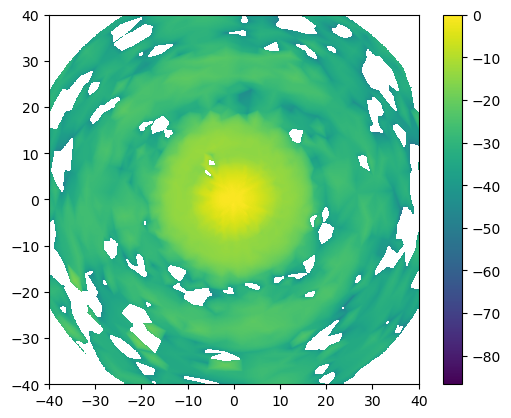

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log10
  """


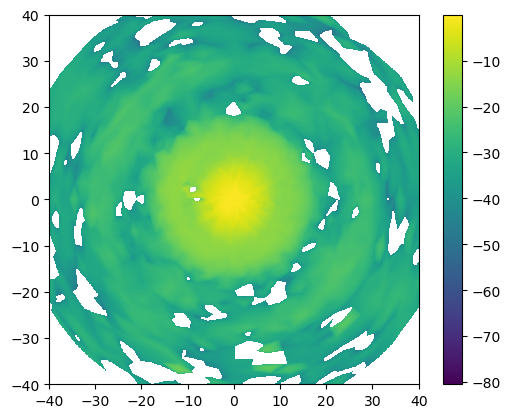

In [860]:

imshow(10*np.log10(Z_dat), extent=(-40,40,-40,40))
colorbar()
show()

imshow(10*np.log10(rotate_data(45)), extent=(-40,40,-40,40))
colorbar()
show()


In [848]:
def rotate_data_general(angle, zdat_lin):
    Xrot, Yrot = rotate((0,0), (X,Y) , angle*np.pi/180)
    Z_dat_rot = griddata((xdat_lin[valid_mask],ydat_lin[valid_mask]), zdat_lin[valid_mask], (Xrot,Yrot), method='linear')
    return(Z_dat_rot)

def objective_function2(angle, Z_dat, zdat_lin):
    rotated_map = rotate_data_general(angle, zdat_lin)
    residual = np.log10(rotated_map) - np.log10(Z_dat)
    return np.nanmean(np.abs(residual)**2)

# Initial guess for the rotation angle
initial_angle = 10
angle_bounds = [(-45, 45)]
options = {'ftol': 1}

chisqrd = {}
for freq in [450,500,550,600]:
    copoldir = 'E'
    pols = E_pols
    f_intern = 0 # only one frequency per file, this is always 0

    find = good_freqs[find_ind_from_freq(freq)] 

    picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'
    with open(picklefile, 'rb') as inp:
        ptest = pickle.load(inp)

    chind = 0 # could change
    zdat_lin = ptest.V_LC_operation[:,:,0,chind].ravel()
    valid_mask = ~np.isnan(zdat_lin)


    Z_dat = file_to_interdata(picklefile, chind)

    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)
    
    
    
    best_angle = None
    min_residual = float('inf')
    residuals = []
    
    for angle in range(angle_bounds[0][0], angle_bounds[0][1] + 1, 1):
        angle = min(angle, angle_bounds[0][1])  # Ensure the angle is within bounds
        residual = objective_function(angle, Z**2)
        residuals.append(residual)
        if residual < min_residual:
            min_residual = residual
            best_angle = angle
    chisqrd[freq] = residuals
    print("Optimized Rotation Angle ", freq, 'MHz: ', best_angle)


Optimized Rotation Angle  450 MHz:  37
Optimized Rotation Angle  500 MHz:  45
Optimized Rotation Angle  550 MHz:  45
Optimized Rotation Angle  600 MHz:  45


/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in log10


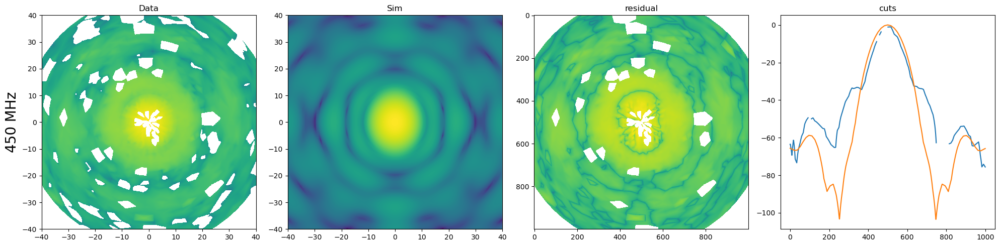

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: invalid value encountered in log


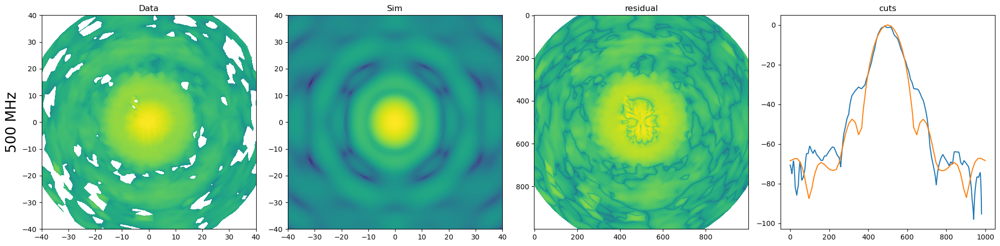

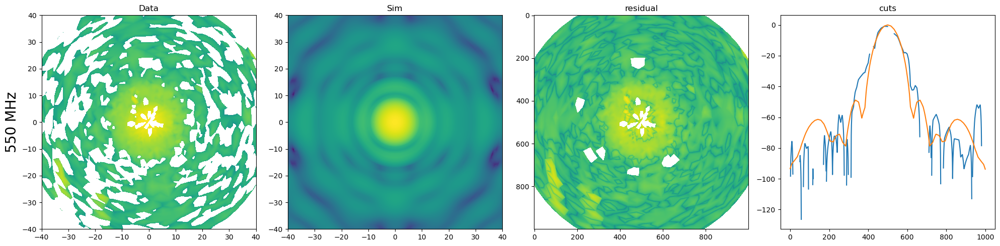

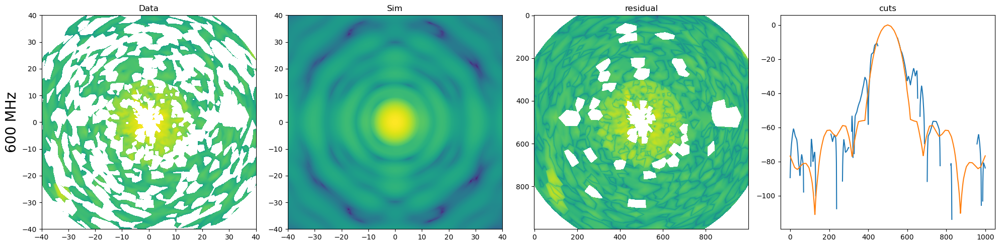

/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:51: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:60: RuntimeWarning: invalid value encountered in log10
/home/erk26/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in log


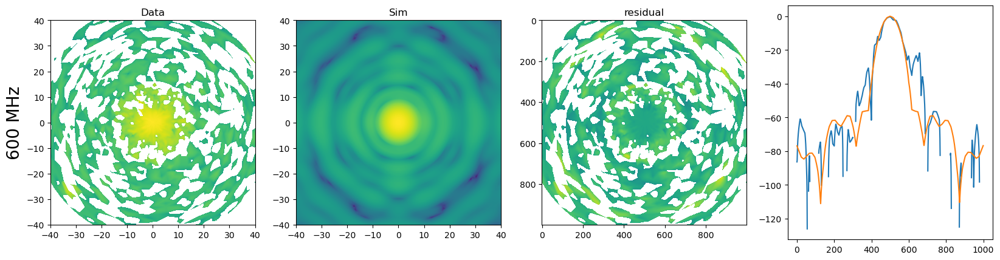

In [861]:
rotangle = 0
chind = 0

for freq in [450,500,550,600]:
    copoldir = 'E'
    pols = E_pols
    f_intern = 0 # only one frequency per file, this is always 0

    find = good_freqs[find_ind_from_freq(freq)] 

    picklefile = beamdir+'Beamcoadd_pol_'+copoldir+'_freq_'+str(find)+'_polar.pkl'

    Z_dat = file_to_interdata(picklefile, chind)
    xdat_lin, ydat_lin, zdat_lin = file_to_lindat(picklefile, chind)

    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-30,30,1000), np.linspace(-30,30,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)

    #plot
    figure(figsize=(20, 5))  # Adjust the figure size as needed
    subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(rotate_data(rotangle)), extent=(-40,40,-40,40))
    title('Data')
    ylabel(str(freq)+' MHz', fontsize = 20)

    subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(Z), extent=(-40,40,-40,40))
    title('Sim')

    subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
    imshow(10*np.log10(np.abs(rotate_data(rotangle)-Z**2)))
    title('residual')

    subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
    plot(10*np.log(rotate_data(rotangle)[500,:]))
    #     plot(10*np.log(Z[:,500][::-1]**2))
    plot(10*np.log(Z[:,500][::-1]**2))
    #     plot(10*np.log(Z[500,:]))

    title('cuts')

    tight_layout() 
    show()

figure(figsize=(20, 5))  # Adjust the figure size as needed
subplot(1, 4, 1)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z_dat), extent=(-40,40,-40,40))
title('Data')
ylabel(str(freq)+' MHz', fontsize = 20)

subplot(1, 4, 2)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z), extent=(-40,40,-40,40))
title('Sim')

subplot(1, 4, 3)  # 1 row, 3 columns, subplot 1
imshow(10*np.log10(Z_dat)-10*np.log10(Z**2))
title('residual')

subplot(1, 4, 4)  # 1 row, 3 columns, subplot 1
plot(10*np.log(Z_dat[500,:]))
#     plot(10*np.log(Z[:,500][::-1]**2))
plot(10*np.log(Z[:,500][::-1]**2))

# FIT SIM FWHM

In [877]:
import scipy.optimize as opt
from scipy.optimize import curve_fit
from scipy.optimize import leastsq
from scipy.optimize import least_squares


def twoD_Gaussian(v, *params):
    [amplitude, xo, yo, sigma_x, sigma_y, theta, offset] = params
    xo = float(xo)
    yo = float(yo)    
    a = (np.cos(theta)**2)/(2*sigma_x**2) + (np.sin(theta)**2)/(2*sigma_y**2)
    b = -(np.sin(2*theta))/(4*sigma_x**2) + (np.sin(2*theta))/(4*sigma_y**2)
    c = (np.sin(theta)**2)/(2*sigma_x**2) + (np.cos(theta)**2)/(2*sigma_y**2)
    g = offset + amplitude*np.exp( - (a*((v[0]-xo)**2) + 2*b*(v[0]-xo)*(v[1]-yo) 
                            + c*((v[1]-yo)**2)))
    return g.ravel()

In [879]:
def get2Dparams(x, y, amplitude):
#         x = list(np.degrees(self.fulldict['thetaX_beam'][dishindx]))
#         y = list(np.degrees(self.fulldict['thetaY_beam'][dishindx]))
#         z = list(self.fulldict['autos'][dishindx][:,freqindx])

    initial_guess = (1, 0, 0, 5, 5, 0, 1)
    popt, pcov = opt.curve_fit(twoD_Gaussian, (x, y), amplitude, p0=initial_guess)
    return(popt, pcov)

initial_guess = (1, 0, 0, 5, 5, 0, 1)

popt, pcov = opt.curve_fit(twoD_Gaussian, (x, y), z, p0=initial_guess)


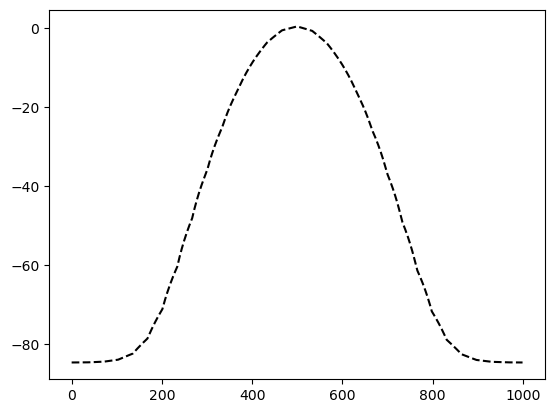

In [895]:
plot(10*np.log(Z_fit[500,:][::-1]**2), 'k--')

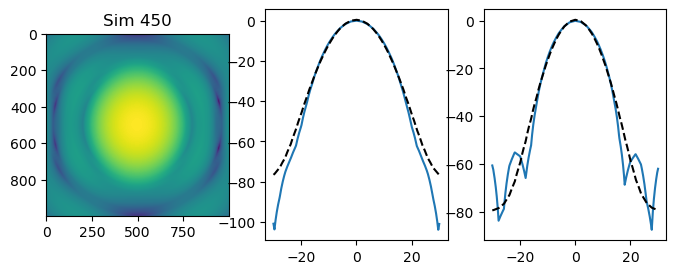

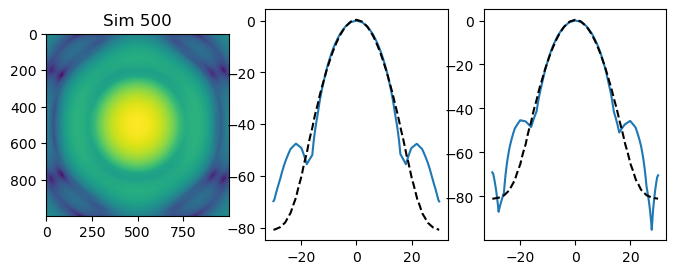

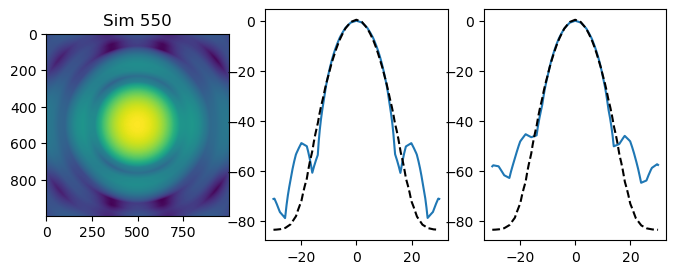

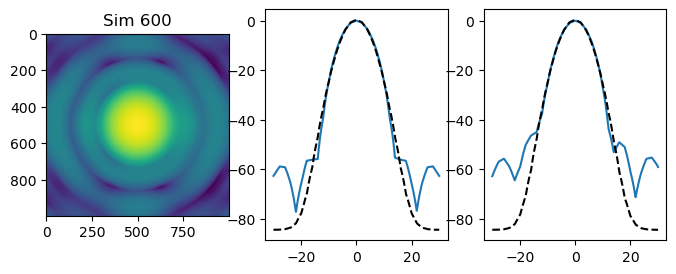

In [897]:
for freq in [450, 500, 550, 600]:
    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-15,15,1000), np.linspace(-15,15,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)
    
    popt, pcov = opt.curve_fit(twoD_Gaussian, (x, y), z/np.max(z), p0=initial_guess)
    Z_fit = griddata((x,y), twoD_Gaussian((x,y), *popt), (X,Y))

    
    figure(figsize=(8, 3))  # Adjust the figure size as needed
    subplot(1, 3, 1)
    imshow(10*np.log10(Z))
    title('Sim '+str(freq))
        
    subplot(1, 3, 2)
    plot(np.linspace(-30,30,1000), 10*np.log(Z[:,500][::-1]**2))
    plot(np.linspace(-30,30,1000), 10*np.log(Z_fit[:,500][::-1]**2), 'k--')
    subplot(1, 3, 3)
    plot(np.linspace(-30,30,1000), 10*np.log(Z[500,:][::-1]**2))
    plot(np.linspace(-30,30,1000), 10*np.log(Z_fit[500,:][::-1]**2), 'k--')


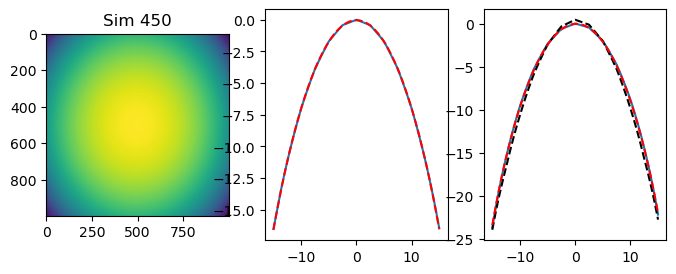

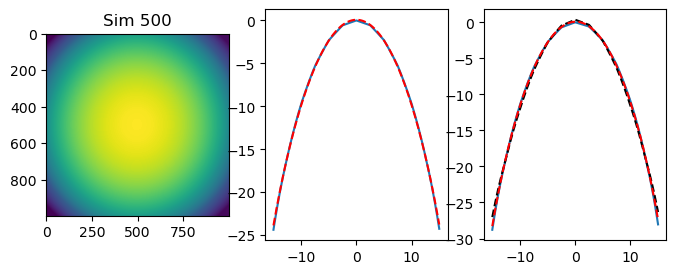

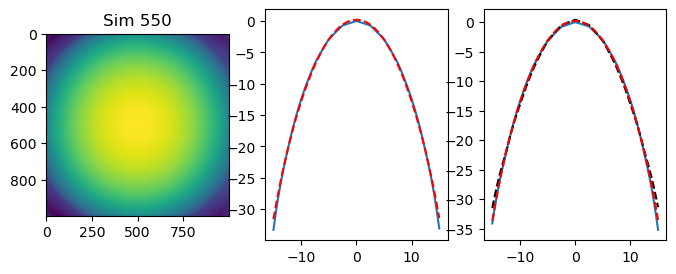

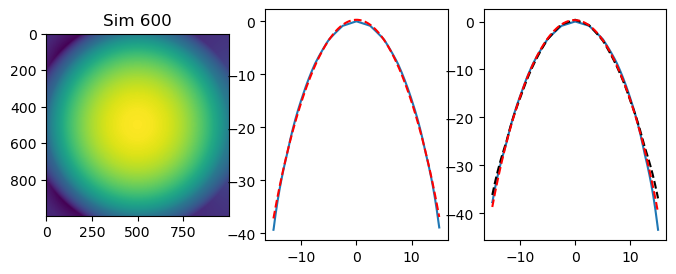

In [1004]:
fitparams = {}
fitparams1 = {}

for freq in [450, 500, 550, 600]:
    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(-6,6,1000), np.linspace(-6,6,1000))
    Z = griddata((x,y), z, (X,Y))
    Z = Z/np.max(Z)
    
    popt, pcov = opt.curve_fit(twoD_Gaussian, (X.ravel(), Y.ravel()), Z.ravel(), p0=initial_guess)

    Z_fit1 = twoD_Gaussian((X.ravel(),Y.ravel()), *popt).reshape(1000,1000)
    fitparams1[freq] = popt
    
    
    popt, pcov = opt.curve_fit(twoD_Gaussian, (x, y), z/np.max(z), p0=initial_guess)
    Z_fit = griddata((x,y), twoD_Gaussian((x,y), *popt), (X,Y))
    fitparams[freq] = popt

    figure(figsize=(8, 3))  # Adjust the figure size as needed
    subplot(1, 3, 1)
    imshow(10*np.log10(Z))
    title('Sim '+str(freq))
        
    subplot(1, 3, 2)
    plot(np.linspace(-15,15,1000), 10*np.log(Z[:,500][::-1]**2))
#     plot(np.linspace(-15,15,1000), 10*np.log(Z_fit[:,500][::-1]**2), 'k--')
    plot(np.linspace(-15,15,1000), 10*np.log(Z_fit1[:,500][::-1]**2), 'r--')
    
    subplot(1, 3, 3)
    plot(np.linspace(-15,15,1000), 10*np.log(Z[500,:][::-1]**2))
    plot(np.linspace(-15,15,1000), 10*np.log(Z_fit[500,:][::-1]**2), 'k--')
    plot(np.linspace(-15,15,1000), 10*np.log(Z_fit1[500,:][::-1]**2), 'r--')


In [993]:
fitparams[freq]

array([ 1.01168544e+00,  4.72004563e-03, -8.65763212e-03,  2.24954005e+00,
        2.31716227e+00,  2.51414580e-03,  5.41305106e-05])

4.5945945945945965 5.225225225225227
4.2342342342342345 4.5045045045045065
3.9039039039039043 4.054054054054054
3.543543543543544 3.693693693693694


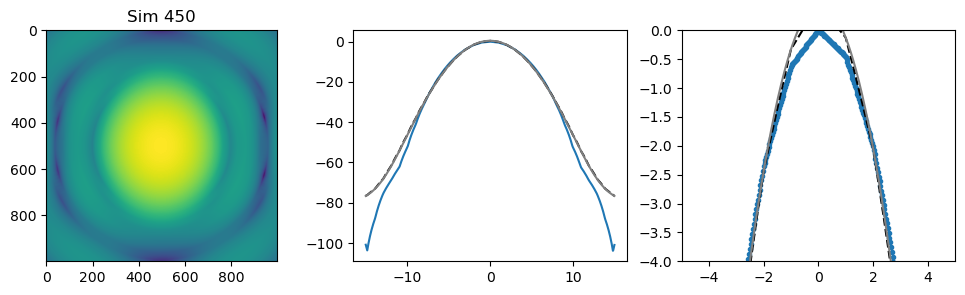

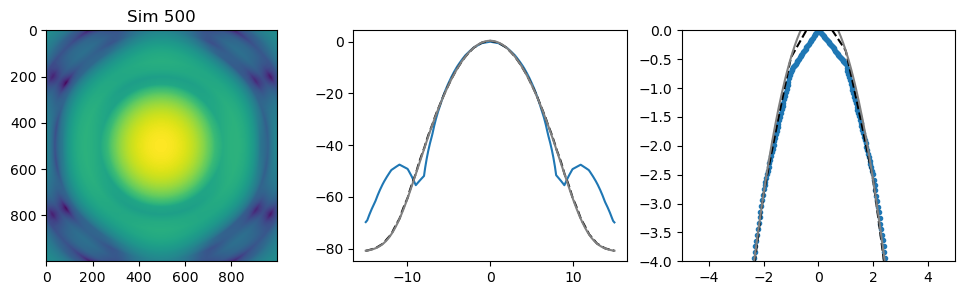

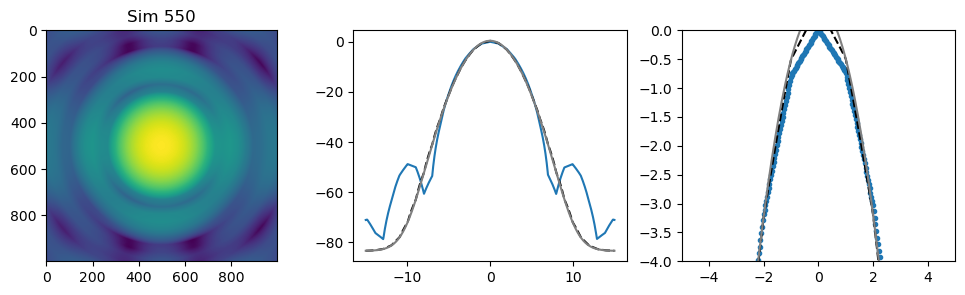

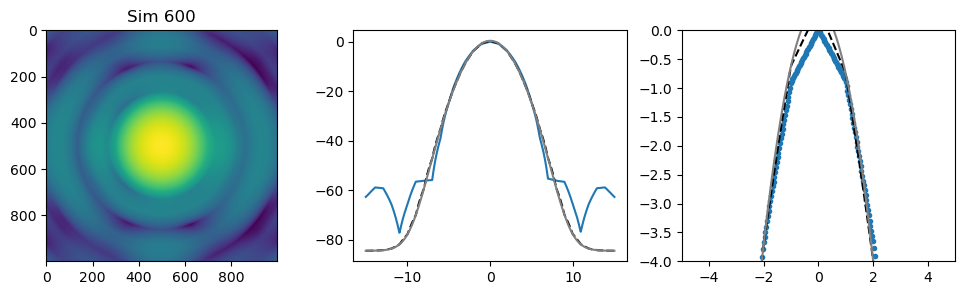

In [1005]:
lb = -15
ub = 15

for freq in [450, 500, 550, 600]:
    x,y = dfs_sims[freq]['position'][0],dfs_sims[freq]['position'][1]
    z = dfs_sims[freq]['mag'][1]

    X,Y = np.meshgrid(np.linspace(lb,ub,1000), np.linspace(lb,ub,1000))
    Z = griddata((x,y), z, (X,Y))
    
    Z = Z/np.max(Z)    
    
    popt = fitparams[freq]
#     Z_fit1 = twoD_Gaussian((X.ravel(),Y.ravel()), *popt).reshape(1000,1000)
    Z_fit = griddata((x,y), twoD_Gaussian((x,y), *popt), (X,Y))
    Z_fit1 = twoD_Gaussian((X.ravel(),Y.ravel()), *popt).reshape(1000,1000)

    figure(figsize=(12, 3))  # Adjust the figure size as needed
    subplot(1, 3, 1)
    imshow(10*np.log10(Z))
    title('Sim '+str(freq))
        
    subplot(1, 3, 2)
    plot(np.linspace(lb,ub,1000), 10*np.log(Z[:,500][::-1]**2))
    plot(np.linspace(lb,ub,1000), 10*np.log(Z_fit[:,500][::-1]**2), 'k--')
    plot(np.linspace(lb,ub,1000), 10*np.log(Z_fit1[:,500][::-1]**2), 'grey')
    
    subplot(1, 3, 3)
    plot(np.linspace(lb,ub,1000), 10*np.log(Z[500,:][::-1]**2), '.')
    plot(np.linspace(lb,ub,1000), 10*np.log(Z_fit[500,:][::-1]**2), 'k--')
    plot(np.linspace(lb,ub,1000), 10*np.log(Z_fit1[500,:][::-1]**2), 'grey')
    ylim(-4,0)
    xlim(-5,5)
    
    cross_indices_x = np.where(np.diff((10*np.log(Z[500,:][::-1]**2) > -3).astype(int)))[0] + 1
    cross_indices_y = np.where(np.diff((10*np.log(Z[:,500][::-1]**2) > -3).astype(int)))[0] + 1
    print(np.linspace(lb,ub,1000)[cross_indices_x][1]-np.linspace(lb,ub,1000)[cross_indices_x][0],\
          np.linspace(lb,ub,1000)[cross_indices_y][1]-np.linspace(lb,ub,1000)[cross_indices_y][0])


In [995]:
for freq in [450, 500, 550, 600]:
    print(freq, 2.355*fitparams[freq][3], 2.355*fitparams[freq][4])

450 6.796549438336321 7.785388379482265
500 6.213528700291321 6.630471860515662
550 5.725359633740391 5.907973525350065
600 5.29766682204905 5.4569171555693075


Text(0.5, 0, 'MHz')

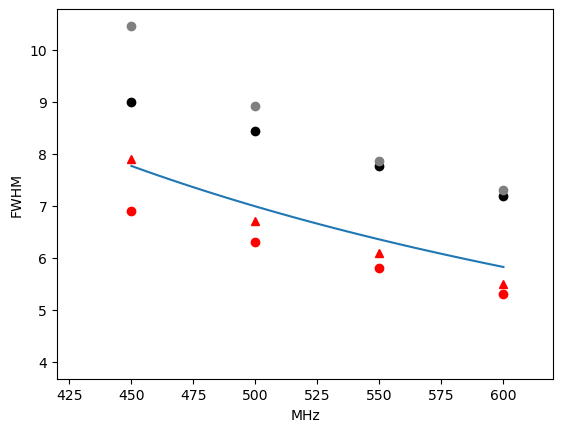

In [1021]:
for freq in [450, 500, 550, 600]:
    plot(freq, 2.355*fitparams[freq][3], 'o', color= 'k')
    plot(freq, 2.355*fitparams[freq][4], 'o', color= 'grey')
    
#     plot(freq, 2.355*fitparams1[freq][3], 'o', color= 'pink')
#     plot(freq, 2.355*fitparams1[freq][4], 'o', color= 'purple')
plot(np.linspace(450, 600, 100), 180/np.pi*1.22*(3e2/np.linspace(450, 600, 100))/6)
# plot(np.linspace(450, 600, 100), 180/np.pi*1.22*(3e2/np.linspace(450, 600, 100))/3)
# plot([450, 500, 550, 600], 2.355*testarr[:,4])
# plot([450, 500, 550, 600], 2.355*testarr[:,3])
fwhms_bensims = [8.9, 7.9, 6.7, 6.1, 5.5, 5.1, 4.9, 6.6, 4.7]
fwhms_bensims_H = [7.7, 6.9, 6.3, 5.8, 5.3, 5, 5.2, 4, 4.2]
plot(np.arange(400,850,50), fwhms_bensims, '^', color = 'r', markersize = 6, label = 'sim cut 1')
plot(np.arange(400,850,50), fwhms_bensims_H, 'ro', label = 'sim cut 1')
xlim(420,620)
ylabel('FWHM')
xlabel('MHz')

In [997]:
1.22*(3e2/np.linspace(450, 600, 100))/6

array([0.13555556, 0.13510067, 0.13464883, 0.1342    , 0.13375415,
       0.13331126, 0.13287129, 0.13243421, 0.132     , 0.13156863,
       0.13114007, 0.13071429, 0.13029126, 0.12987097, 0.12945338,
       0.12903846, 0.1286262 , 0.12821656, 0.12780952, 0.12740506,
       0.12700315, 0.12660377, 0.1262069 , 0.1258125 , 0.12542056,
       0.12503106, 0.12464396, 0.12425926, 0.12387692, 0.12349693,
       0.12311927, 0.1227439 , 0.12237082, 0.122     , 0.12163142,
       0.12126506, 0.1209009 , 0.12053892, 0.1201791 , 0.11982143,
       0.11946588, 0.11911243, 0.11876106, 0.11841176, 0.11806452,
       0.1177193 , 0.11737609, 0.11703488, 0.11669565, 0.11635838,
       0.11602305, 0.11568966, 0.11535817, 0.11502857, 0.11470085,
       0.114375  , 0.11405099, 0.11372881, 0.11340845, 0.11308989,
       0.11277311, 0.1124581 , 0.11214485, 0.11183333, 0.11152355,
       0.11121547, 0.11090909, 0.1106044 , 0.11030137, 0.11      ,
       0.10970027, 0.10940217, 0.10910569, 0.10881081, 0.10851

In [998]:
testarr = np.zeros((4,7))

for i, key in enumerate(fitparams.keys()):
    testarr[i] = fitparams[key]

In [999]:
fitparams.keys()

dict_keys([450, 500, 550, 600])

In [1000]:
testarr[:,4]

array([3.3058974 , 2.81548699, 2.50869364, 2.31716227])

In [1012]:
cross_indices = np.where(np.diff((10*np.log(Z[500,:][::-1]**2) > -3).astype(int)))[0] + 1
np.linspace(lb,ub,1000)[cross_indices][1]-np.linspace(lb,ub,1000)[cross_indices][0]


3.543543543543544

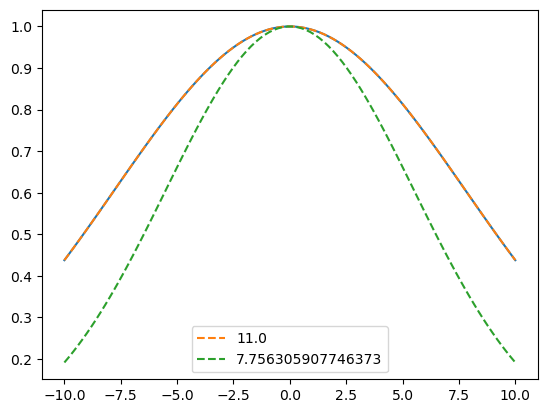

In [1038]:
x = np.linspace(-10,10,100)
y = np.linspace(-10,10,100)
initial_guess = (1, 0, 0, 11, 11, 0, 0)
z = twoD_Gaussian((x,y), *initial_guess)

plot(x, twoD_Gaussian((x,y), *initial_guess))

popt, pcov = opt.curve_fit(twoD_Gaussian, (x, y), z, p0=initial_guess)
gauss_fit_attempt = twoD_Gaussian((x,y), *popt)

plot(x, gauss_fit_attempt, '--', label = popt[3])


popt, pcov = opt.curve_fit(twoD_Gaussian, (x, y), z**2, p0=initial_guess)
gauss_fit_attempt = twoD_Gaussian((x,y), *popt)

plot(x, gauss_fit_attempt, '--', label = popt[3])
legend()

In [1040]:
def convfwhm(fwhm):
    x = np.linspace(-10,10,100)
    y = np.linspace(-10,10,100)
    initial_guess = (1, 0, 0, fwhm, fwhm, 0, 0)
    z = twoD_Gaussian((x,y), *initial_guess)
    popt, pcov = opt.curve_fit(twoD_Gaussian, (x, y), z**2, p0=initial_guess)
    return(popt[3])

Text(0.5, 0, 'MHz')

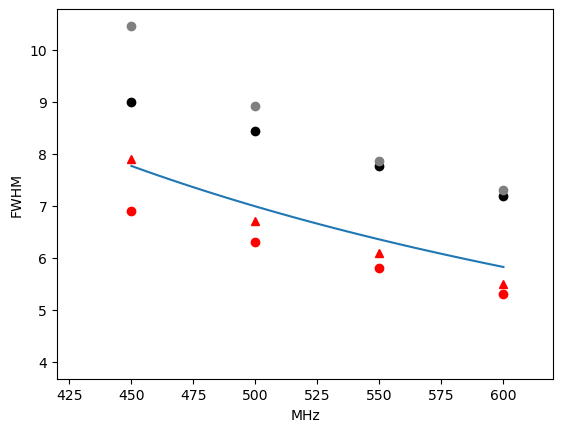

In [1048]:
for freq in [450, 500, 550, 600]:
    plot(freq, 2.355*fitparams[freq][3], 'o', color= 'k')
    plot(freq, 2.355*fitparams[freq][4], 'o', color= 'grey')

plot(np.linspace(450, 600, 100), 180/np.pi*1.22*(3e2/np.linspace(450, 600, 100))/6)


newfwhm1 = []
for fwhm in fwhms_bensims: newfwhm1.append(convfwhm(fwhm))
newfwhm2 = []
for fwhm in fwhms_bensims_H: newfwhm2.append(convfwhm(fwhm))


fwhms_bensims = [8.9, 7.9, 6.7, 6.1, 5.5, 5.1, 4.9, 6.6, 4.7]
fwhms_bensims_H = [7.7, 6.9, 6.3, 5.8, 5.3, 5, 5.2, 4, 4.2]
plot(np.arange(400,850,50), fwhms_bensims, '^', color = 'r', markersize = 6, label = 'sim cut 1')
plot(np.arange(400,850,50), fwhms_bensims_H, 'ro', label = 'sim cut 1')


plot(np.arange(400,850,50), newfwhm1, 'ro', label = 'sim cut 1')
plot(np.arange(400,850,50), newfwhm2, 'ro', label = 'sim cut 1')

xlim(420,620)
ylabel('FWHM')
xlabel('MHz')

In [1046]:
newfwhm = []
for fwhm in fwhms_bensims: newfwhm.append(convfwhm(fwhm))

/home/erk26/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:834: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


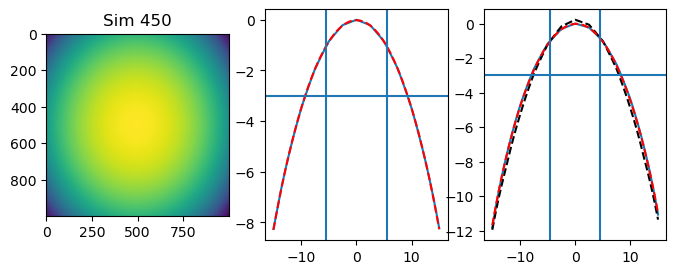

In [1057]:
fitparams = {}
fitparams1 = {}

for freq in [450]:

    figure(figsize=(8, 3))  # Adjust the figure size as needed
    subplot(1, 3, 1)
    imshow(10*np.log10(Z))
    title('Sim '+str(freq))
        
    subplot(1, 3, 2)
    plot(np.linspace(-15,15,1000), 10*np.log(Z[:,500][::-1]))
#     plot(np.linspace(-15,15,1000), 10*np.log(Z_fit[:,500][::-1]**2), 'k--')
    plot(np.linspace(-15,15,1000), 10*np.log(Z_fit1[:,500][::-1]), 'r--')
    
    axvline(-5.5)
    axvline(5.5)
    
#     axvline(-4.5)
#     axvline(4.5)
    
    axhline(-3)
    
    
    subplot(1, 3, 3)
    plot(np.linspace(-15,15,1000), 10*np.log(Z[500,:][::-1]))
    plot(np.linspace(-15,15,1000), 10*np.log(Z_fit[500,:][::-1]), 'k--')
    plot(np.linspace(-15,15,1000), 10*np.log(Z_fit1[500,:][::-1]), 'r--')

    
#     axvline(-5.5)
#     axvline(5.5)
    
    axvline(-4.5)
    axvline(4.5)
    
    axhline(-3)